# Week 5 - Classifying Meanings & Documents

Recall that Week 1 of this course focused on how to find and extract text data, while weeks 2 through 4 each covered a different type of content representations:

2. computational linguistics (e.g., keyword count)
3. clustering and topic modeling (e.g., LDA)
4. embeddings (e.g., _word2vec_)

Now we show how classification, arguably the most common social science task, can be done with different representations. Note that the second representation, *clustering*, allows us to stably partition text data (e.g., documents, turns of conversation) according to all patterns of covariation among available text features. Classification, by contrast, partitions text data according to only those features and their variation that enable us to mimic and extrapolate human annotations.

We will show how to use a variety of classification methods, including Logistic regression, K-nearest neighbor, decision trees and random forests, support vector machines and even a simple neural network, the perceptron. We will also demonstrate ensemble techniques that can link several such methods into a single, more accurate, classification pipeline. We will finally learn to use conventions and metrics to evaluate classifier performance on out-of-sample data. 

In [1]:
#Special module written for this class
#This provides access to data and to helper functions from previous weeks
#Make sure you update it before starting this notebook
# ! pip install -U git+git://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git
import lucem_illud #pip install -U git+git://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git

#All these packages need to be installed from pip
#For ML
import sklearn
import sklearn.naive_bayes
import sklearn.tree
import sklearn.ensemble
import sklearn.neural_network
import sklearn.decomposition

import numpy as np #arrays
import matplotlib.pyplot as plt #Plots
import matplotlib.colors # For nice colours
import seaborn #Makes plots look nice, also heatmaps
import scipy as sp #for interp

import pyanno #On python3 make sure to pip install pyanno3

#We need to import these this way due to how pyanno is setup
from pyanno.measures import pairwise_matrix, agreement, cohens_kappa, cohens_weighted_kappa, fleiss_kappa, krippendorffs_alpha, pearsons_rho, scotts_pi, spearmans_rho
from pyanno.annotations import AnnotationsContainer
from pyanno.models import ModelA, ModelBt, ModelB

from functools import reduce
from itertools import permutations
import math

#These are from the standard library
import collections
import os
import os.path
import random
import re
import glob
import pandas
import requests
import json
import math

#This 'magic' command makes the plots work better
#in the notebook, don't use it outside of a notebook.
#Also you can ignore the warning
%matplotlib inline

# Annotations

This is a course on "computational" content analysis, but the best computer today is arguably still the human brain. Our aim is to augment human intelligence and scholarship. One of the most important strategies is to have real, live _Homo sapiens_ annotate text, assigning numbers or categories to individual texts. We can computationally compare annotations across humans, and we can use annotations to train computational models.

Let's take a quick look at Rzhetsky et al (2009)'s sample dataset, which can be found [here](https://github.com/enthought/uchicago-pyanno/tree/master/data). This data is the result of a content analytic / content extraction study in which Andrey Rzhetsky and colleagues from the National Library of Medicine, published [here](http://journals.plos.org/ploscompbiol/article?id=10.1371/journal.pcbi.1000391) in [PLOS Computational Biology](http://journals.plos.org/ploscompbiol/), gave eight annotators 10,000 sentence chunks from biomedical text in biomedical abstracts and articles, then asked them, in a loop design schematically illustrated below that provided 3 independent codings for each document. The sampling strategy pursued diversity by drawing from PubMed abstracts (1000) and full-text articles (9000: 20% from abstracts, 10% from introductions, 20% from methods, 25% from results, and 25% from discussions.) The dataset extract here involves respondents codes for sentences in terms of their *Evidence*: {0, 1, 2, 3, -1} where 0 is the complete lack of evidence, 3 is direct evidence present within the sentence, and -1 is didn't respond. (They also crowdsourced and analyzed *polarity*, *certainty*, and *number*). For example, consider the following two abutting sentence chunks: *"Because null mutations in toxR and toxT abolish CT and TcpA expression in the El Tor biotype and also attenuate virulence..."* [i.e., average certainty = 0], *"...it is likely that the ToxR regulon has functional similarities between the two biotypes despite the clear differences in the inducing parameters observed in vitro"* [i.e., average certainty = 1]."

<img src="https://github.com/UChicago-Computational-Content-Analysis/Homework-Notebooks/blob/main/data/loopdesign.png?raw=true" alt="https://github.com/UChicago-Computational-Content-Analysis/Homework-Notebooks/blob/main/data/loopdesign.png?raw=true" style="width:500px">

In [ ]:
# Remember if you are on Google Colab, you need to upload or `git clone` the datafile
# and your path will probably be something like "#content/drive/MyDrive//data/pyAnno/testdata_numerical.txt"
x = np.loadtxt("../data/pyAnno/testdata_numerical.txt")
anno = AnnotationsContainer.from_array(x, missing_values=[-1])
# -1 means that these coders didn't respond

Interrogate the AnnotationsContainer object.

In [ ]:
anno.annotations

In [ ]:
anno.annotations[1, :]

In [ ]:
len(anno.annotations)

In [ ]:
anno.labels

In [ ]:
anno.missing_values

# Annotation Statistics

First, we assume categorical codes...that each code is qualitatively distinct from each other. Two measures are primarily used for this: Scott's $\pi$, Cohen's $\kappa$, and Krippendorff's $\alpha$ which each measure the extent of agreement between two annotators, but take into account the possibility of the agreement occurring by chance in slightly different ways. Any agreement measure begins with the frequency of codes:

In [ ]:
pyanno.measures.agreement.labels_frequency(anno.annotations,4)

Now consider the "confusion matrix" or matrix of coded agreements between any two coders:

In [ ]:
c = pyanno.measures.agreement.confusion_matrix(anno.annotations[:,0], anno.annotations[:,1],4)
print(c)
ac = seaborn.heatmap(c)
plt.show()

Scott's $\pi$ is computed as:

$\pi = \frac{\text{Pr}(a)-\text{Pr}(e)}{1-\text{Pr}(e)}$

Where Pr($a$) is relative observed agreement, and Pr($e$) is expected agreement using joint proportions calculated from the confusion matrix or matrix of coded agreements between any two coders:

In [ ]:
scotts_pi(anno.annotations[:,0], anno.annotations[:,1])

The generalization of Scott's $\pi$ to $n$ coders is Fleiss' $\kappa$ (Fleiss called it $\kappa$ because he thought he was generalizing Cohen's $\kappa$)

In [ ]:
fleiss_kappa(anno.annotations[::])

Krippendorff's $\alpha$ generalizes of Fleiss' $\kappa$ to $n$ coders and takes into account the fact that annotations here are not categorically different, but ordinal, by adding a weight matrix in which off-diagonal cells contain weights indicating the seriousness of the disagreement between each score. When produced with no arguments, it simply produces an arithmetic distance (e.g., 3-1=2), such that cells one off the diagonal are weighted 1, two off 2, etc.

In [ ]:
krippendorffs_alpha(anno.annotations[::])

Like Scott's $\pi$, Cohen's $\kappa$ also takes into account the possibility of the agreement occurring by chance, but in the following way:

$\kappa = \frac{p_o-p_e}{1-p_e}=1-\frac{1-p_o}{p_e}$

where $p_o$ is the relative observed agreement among raters, and $p_e$ is the hypothetical probability of chance agreement, using the observed data to calculate the probabilities of each observer randomly saying each category. If the raters are in complete agreement then $\kappa = 1$. If there is no agreement among the raters other than what would be expected by chance (as given by $p_e$), $\kappa ≤ 0 $. Here, Cohen's $\kappa$ statistic for the first two annotators is computed. This is probably the most common metric of agreement.

In [ ]:
cohens_kappa(anno.annotations[:,0], anno.annotations[:,1])

In [ ]:
m = pairwise_matrix(cohens_kappa, anno.annotations)
print(m)
# each coder overlaps with  four other coders

In [ ]:
ax = seaborn.heatmap(m)
plt.show()

You can see that this 8 by 3 loop design will be less stable than an 8 choose 3 combinatorial design, because each codes with more others. 

One can also assess the average Cohen's $\kappa$ for all pairs of coders that have coded against one another:

In [36]:
def pairwise_metric_average(metric, array):
    """Calculate the pairwise metric average for the real elements of metric function run on an array of annotations"""
    p = permutations(range(array[0,:].size),2)
    m = [metric(array[:,x[0]], array[:,x[1]]) for x in p]
    clean_m = [c for c in m if not math.isnan(c)]
    return reduce(lambda a, b: a + b, clean_m)/len(clean_m)    
 
# pairwise_metric_average(cohens_kappa, anno.annotations)

As recognized with Krippendorff's flexible $\alpha$, our scores are *not* categorical, but rather ordered and her considered metric. Weighted $\kappa$ allows you to count disagreements differently and is useful when codes are ordered as they are here. Here a weight matrix is added to the calculation, in which off-diagonal cells contain weights indicating the seriousness of the disagreement between each score. When automatically produced, it simply produces an arithmetic distance (e.g., 3-1=2), such that cells one off the diagonal are weighted 1, two off 2, etc. Here

$\kappa = 1-\frac{\sum^k_{i=1}\sum^k_{j=1}w_{ij}x_{ij}}{\sum^k_{i=1}\sum^k_{j=1}w_{ij}m_{ij}}$

where $\kappa$ = $n$ codes and $w_{ij}$,$x_{ij}$, and $m_{ij}$ represent elements in the weight, observed, and expected matrices, respectively. (Obviously, when diagonal cells contain weights of 0 and off-diagonal cells weights of 1, this equals $\kappa$).

In [ ]:
cohens_weighted_kappa(anno.annotations[:,0], anno.annotations[:,1])

Or averaged over the total:

In [ ]:
pairwise_metric_average(cohens_weighted_kappa,anno.annotations)

Alternatively, if the annontation data can be understood as indicating real values, we can assess not agreement, but rather the correlation of values (Pearson's $\rho$) or correlation of ranks (Spearman's $\rho$) for pairs of coders:

In [ ]:
n = pairwise_matrix(pearsons_rho, anno.annotations)
m = pairwise_matrix(spearmans_rho, anno.annotations)
an = seaborn.heatmap(n)
plt.show()
am = seaborn.heatmap(m)
plt.show()

Or averaged over all comparable pairs:

In [ ]:
print(pairwise_metric_average(pearsons_rho,anno.annotations), pairwise_metric_average(spearmans_rho,anno.annotations))

## <font color="red">*Exercise 1*</font>

<font color="red">Perform a content annotation survey of some kind in which at least 3 people evaluate and code each piece of content, using Amazon Mechanical Turk as described in the [MTurk slides on Canvas](https://canvas.uchicago.edu/courses/39937/files/6674661?wrap=1), or by hand with friends.  With the resulting data, calculate, visualize and discuss inter-coder agreement or covariation with appropriate metrics. What does this means for the reliability of human assessments regarding content in your domain?

In this exercise I asked three of my friends to evaluate the sentiment of 50 movie reviews. Codes are {0,1,2,3} where 0 is merely description of some plots of the movie, 1 contains (mild) attitude of reviewers, 2 means a comment is strong enough that could possibly influence other people's opinions, and 3 indicates extreme positive or negative sentiments. 

In [2]:
import pandas as pd 

In [6]:
rating1 = pd.read_excel('/Users/mao_shiba/Desktop/2021-Content-Analysis/Homework-Notebooks/week-5/Coder_1.xlsx')
rating2 = pd.read_excel('/Users/mao_shiba/Desktop/2021-Content-Analysis/Homework-Notebooks/week-5/Coder_2.xlsx')
rating3 = pd.read_excel('/Users/mao_shiba/Desktop/2021-Content-Analysis/Homework-Notebooks/week-5/Coder_3.xlsx')

In [25]:
rating = pd.DataFrame({'coder1': rating1['Score'], 
                       'coder2':rating2['Score'], 
                       'coder3':rating3['Score']})
rating.head()

,coder1,coder2,coder3
0,3,3,3
1,0,0,1
2,3,0,2
3,0,0,0
4,1,1,2


In [26]:
rating_array = rating.values

[[17.  2.  0.  0.]
 [ 6.  6.  2.  0.]
 [ 0.  3.  5.  0.]
 [ 1.  0.  2.  6.]]


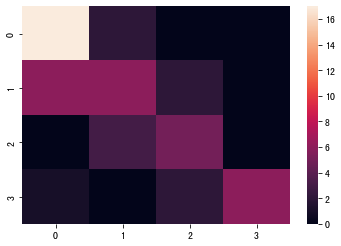

In [27]:
c1 = pyanno.measures.agreement.confusion_matrix(rating_array[:,0], rating_array[:,1], 4)
print(c1)
ac = seaborn.heatmap(c1)
plt.show()

[[9. 8. 2. 0.]
 [1. 6. 5. 2.]
 [0. 1. 7. 0.]
 [0. 0. 1. 8.]]


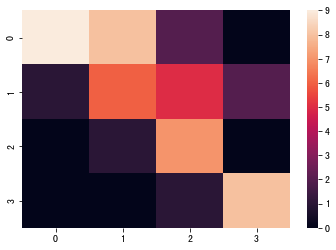

In [29]:
c2 = pyanno.measures.agreement.confusion_matrix(rating_array[:,0], rating_array[:,2], 4)
print(c2)
ac = seaborn.heatmap(c2)
plt.show()

[[10.  9.  5.  0.]
 [ 0.  4.  6.  1.]
 [ 0.  2.  4.  3.]
 [ 0.  0.  0.  6.]]


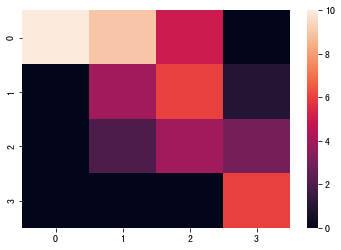

In [30]:
c3 = pyanno.measures.agreement.confusion_matrix(rating_array[:,1], rating_array[:,2], 4)
print(c3)
ac = seaborn.heatmap(c3)
plt.show()

In [39]:
m = pairwise_matrix(cohens_kappa, rating_array)
print(m)

[[1.         0.54648526 0.47089947]
 [0.54648526 1.         0.31578947]
 [0.47089947 0.31578947 1.        ]]


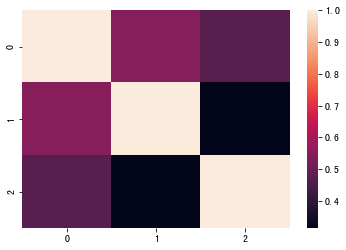

In [38]:
ax = seaborn.heatmap(m)
plt.show()

In [41]:
krippendorffs_alpha(rating_array[::])

0.7231409565572857

In [40]:
pairwise_metric_average(cohens_kappa, rating_array)

0.4443914017848855

Well, what we can learn from this survey is that coding sentiment for movie reviews is not a easy task. From the first three heatmaps we can know that every coder disagrees with each other to some extent, though they can reach agreement in most cases as indicated by krippendorffs $\alpha$ score. It's relatively easy for us to reach consensus on which comments are subjective descriptions. We can also tell the difference between mild sentiments and extreme sentiments. But it's more difficult for us to discern the differences between sentiment level of 0 and 1, 1 and 2, or 2 and 3. This suggests that though it's feasible to use human coders to code sentiment, the results can contain large noises as the criteria are not standardized. Using computationally-enhanced tools may be better and more efficient. Human coders could serve as experts to scrutinize the results returned by algorithms. 

# Simple Simulated Examples for Classification

Here we create a sandbox for you to explore different types of classified data and how different statistical classifiers perform on each type.

## Generating example data

We start by loading one of the "cartoon" or simplified data sets and then dividing it into training and testing sets. To maximize our ability to visualize, each dataset involves two classes, colored yellow and blue, arrayed along two dimensions (`x` and `y`). 

The four data patterns include: 
+ `random` in which the two classes are randomly distributed across both dimensions
+ `andSplit` in which the two classes are linearly split along one of two dimensions (e.g., men like Adidas)
+ `xorSplit` in which the two classes are split, oppositely, along each dimension (e.g., old ladies and young men like Nikes)
+ `targetSplit` in which one class is nested within the other in two dimensions (e.g., middle aged, middle income people like vintage Mustangs)
+ `multiBlobs` in which 5 classes are placed as bivariate Gaussians at random locations

`noise` is a variable [0-1] that ranges from no noise in the prescribed pattern [0] to complete noise/randomness [1].

Uncomment (remove the # in front of) each dataset, one at a time, and then run the cell and subsequent cells to examine how each machine learning approach captures each pattern.

We use the popular `train_test_split()` function from `sklearn`, and the data pattern function source code is copied below for your convenience from `lucem_illud`'s [cartoons.py](https://github.com/UChicago-Computational-Content-Analysis/lucem_illud/blob/main/lucem_illud/cartoons.py) file.

In [42]:
def random(numPerCategory = 500):
    datDict = {
        'vect' : [np.random.rand(2) * 2 - 1 for i in range(2 * numPerCategory)],
        'category' : [i % 2 for i in range(2 * numPerCategory)],
    }

    return pandas.DataFrame(datDict)

def andSplit(noise = 0, numPerCategory = 500):
    def genPoint(cat):
        y = np.random.random_sample() * 2 - 1
        if noise >= 0:
            x = np.random.random_sample() - cat - (np.random.random_sample() - cat) * noise
        else:
            x = (1 - noise * np.random.random_sample()) - cat
        return np.array([x, y])
    datDict = {
        'vect' : [genPoint(i % 2) for i in range(2 * numPerCategory)],
        'category' : [i % 2 for i in range(2 * numPerCategory)],
    }

    return pandas.DataFrame(datDict)

def xorSplit(noise = 0, numPerCategory = 500):
    def genPoint(cat):
        if cat == 1:
            if np.random.randint(0,2) < 1:
                y = np.random.random_sample() - np.random.random_sample() * noise * 2
                x = np.random.random_sample() - np.random.random_sample() * noise * 2
            else:
                y = np.random.random_sample() - 1 - np.random.random_sample() * noise * 2
                x = np.random.random_sample() - 1 - np.random.random_sample() * noise * 2
        else:
            if np.random.randint(0,2) < 1:
                y = np.random.random_sample() - 1 - np.random.random_sample() * noise * 2
                x = np.random.random_sample() - np.random.random_sample() * noise * 2
            else:
                y = np.random.random_sample() - np.random.random_sample() * noise * 2
                x = np.random.random_sample() - 1 - np.random.random_sample() * noise * 2
        return np.array([x, y])

    datDict = {
        'vect' : [genPoint(i % 2) for i in range(2 * numPerCategory)],
        'category' : [i % 2 for i in range(2 * numPerCategory)],
    }

    return pandas.DataFrame(datDict)

def targetSplit(noise = 0, numPerCategory = 500, innerRad = .3):
    def genPoint(cat):
        if cat == 0:
            r = np.random.random_sample() * innerRad + (1 - innerRad) * np.random.random_sample() * noise
        else:
            r = np.random.random_sample() * (1 - innerRad) + innerRad - innerRad * np.random.random_sample() * noise
        eta = 2 * np.pi * np.random.random_sample()
        return np.array([r * np.cos(eta), r * np.sin(eta)])

    datDict = {
        'vect' : [genPoint(i % 2) for i in range(2 * numPerCategory)],
        'category' : [i % 2 for i in range(2 * numPerCategory)],
    }

    return pandas.DataFrame(datDict)

def multiBlobs(noise = 0, numPerCategory = 500, centers = 5):
    if isinstance(centers, int):
        n_samples = numPerCategory * centers
    else:
        n_samples = numPerCategory * len(centers)
    X, y = sklearn.datasets.make_blobs(n_samples=n_samples, centers=centers, cluster_std = (.8 * (noise * 2 + 1)))
    datDict = {
        'vect' : list(X),
        'category' : y,
    }
    return pandas.DataFrame(datDict)

In [43]:
noise = .2

dfTrain, dfTest = sklearn.model_selection.train_test_split(lucem_illud.random(), test_size=.2)
# dfTrain, dfTest = sklearn.model_selection.train_test_split(lucem_illud.andSplit(noise), test_size=.2)
# dfTrain, dfTest = sklearn.model_selection.train_test_split(lucem_illud.xorSplit(noise), test_size=.2)
# dfTrain, dfTest = sklearn.model_selection.train_test_split(lucem_illud.targetSplit(noise), test_size=.2)
# dfTrain, dfTest = sklearn.model_selection.train_test_split(lucem_illud.multiBlobs(noise), test_size=.2)

We can easily visualize the rendered datasets because they are generated in two dimensions.

Let's see what dfTrain, a simulated data that we just made, looks like

In [ ]:
dfTrain

So, dfTrain has two columns, vect and category. We can plot this with `plotter()` from [lucem_illud/lucem_illud/cartoons.py](https://github.com/UChicago-Computational-Content-Analysis/lucem_illud/blob/main/lucem_illud/cartoons.py). Here's the source code:

In [ ]:
def plotter(df):
    fig, ax = plt.subplots(figsize = (10,10))
    pallet = seaborn.color_palette(palette='rainbow', n_colors= len(set(df['category'])))
    for i, cat in enumerate(set(df['category'])):
        a = np.stack(df[df['category'] == cat]['vect'])
        ax.scatter(a[:,0], a[:, 1], c = pallet[i], label = cat)
    ax.legend(loc = 'center right', title = 'Categories')
    ax.axis('off')
    plt.show()
    plt.close()

In [ ]:
lucem_illud.plotter(dfTrain)

## Training a Machine Learning algorithm

We can now pick a model, there are many more options in `scikit-learn`. These are just a few examples, which array along the machine learning "tribes" described in Pedro Domingos _The Master Algorithm_.

Uncomment (remove the # in front of) each algorithm one at a time, then run the cell and subsequent cells to evaluate how it learns to understand the data.

In [ ]:
#Bayes
# clf = sklearn.naive_bayes.GaussianNB()

#Analogizes
clf = sklearn.svm.SVC(kernel = 'linear', probability = True) #slow, set probability = False to speed up
#clf = sklearn.svm.SVC(kernel = 'poly', degree = 3, probability = True) #slower
# clf = sklearn.neighbors.KNeighborsClassifier(5, weights='distance')# k, 'distance' or 'uniform'

#Classical Regression
#clf = sklearn.linear_model.LogisticRegression()

#Symbolists
#clf = sklearn.tree.DecisionTreeClassifier()
#clf = sklearn.ensemble.RandomForestClassifier()

#Connectionists
#clf = sklearn.neural_network.MLPClassifier()

#Ensemble
#clf = sklearn.ensemble.GradientBoostingClassifier()

We're using sklearn here. What is sklearn? It's an open source machine learning library for Python. We use sklearn because it features various machine learning algorithms and it works well with NumPy library. You don't need to understand the sklearn package in detail for the moment, but let's see what methods and attributes sklearn has, because we're going to use some of them:

In [ ]:
dir(sklearn)

Now we fit the model by giving it our training data

In [ ]:
clf.fit(np.stack(dfTrain['vect'], axis=0), dfTrain['category'])

Here, "stack" function is used. Why did we use stack function here? This is because dfTrain['vect'] is a sequence, while clf.fit() takes an array element. Let's see what dfTrain['vect'] looks like:

In [ ]:
dfTrain['vect']

And let's see what np.stack(dfTrain['vect']) does:

In [ ]:
np.stack(dfTrain['vect'])

As you can see, stack function takes a sequence of arrays (which have the same shape) and joins them along a new axis.

## Algorithm evaluation

We can look at few measurements of each classifier's performance by using the testing set. These `lucem_illud` functions are in [metrics.py](https://github.com/UChicago-Computational-Content-Analysis/lucem_illud/blob/main/lucem_illud/metrics.py), and we will skip copying source code this time due to length.

In [ ]:
lucem_illud.evaluateClassifier(clf, dfTest)

This lets us look at which classes do better:

In [ ]:
lucem_illud.plotConfusionMatrix(clf, dfTest)

The greater the area under the curve the better.

In [ ]:
lucem_illud.plotMultiROC(clf, dfTest)

We can also look at the regions the classifer identifies as one class or the other:

In [ ]:
lucem_illud.plotregions(clf, dfTrain)

## Now we do the same for real data

Available data sets include:
+ Reddit threads "classified" by thread topic
+ 20 newsgroups "classified" by group topic
+ Senate press releases "classified" by Senator (2 senators)
+ Senate press releases "classified" by Senator (5 senators)
+ Emails classified as Spam or Ham

Note that if you're on Google Colab and have not `git clone`ed the [class repo](https://github.com/UChicago-Computational-Content-Analysis/Homework-Notebooks), you can set a `dataDirectory=` argument to match the path on Colab.

In [67]:
# dfTrain, dfTest = sklearn.model_selection.train_test_split(lucem_illud.loadReddit(dataDirectory='../data/'), test_size=.2)
dfTrain, dfTest = sklearn.model_selection.train_test_split(lucem_illud.loadReddit(), test_size=.2)
#dfTrain, dfTest = sklearn.model_selection.train_test_split(lucem_illud.loadNewsGroups(), test_size=.2)
#dfTrain, dfTest = sklearn.model_selection.train_test_split(lucem_illud.loadSenateSmall(), test_size=.2)
#dfTrain, dfTest = sklearn.model_selection.train_test_split(lucem_illud.loadSenateLarge(), test_size=.2)
#dfTrain, dfTest = sklearn.model_selection.train_test_split(lucem_illud.loadSpam(), test_size=.2)

Loading Reddit data
Converting to vectors


/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'story'. Check that your pipeline includes components that assign token.pos, typically 'tagge

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clause'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'documents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'create'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'previous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/talesfromtechsupport/comments/5ltdyz/why_consistent_password_policies_are_important/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annot

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '4](http://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2blg90'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jack_the_worst_end_user_part_4/'. Check that your pipelin

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'provides'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'miles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'existent'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'veteran'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '80s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '90s'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'structural'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '~10'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inquiries'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aimed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'partners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gathered'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'studying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'university'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'natty'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'organisation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'phil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'acts'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'universe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'belligerent'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'l1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frequent'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'underlings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'becoming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'popular'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recounts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pizzas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contains'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'caters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'paystubs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'banking'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'startup'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'platform'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'corp'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gentlemen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'henceforth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'staffingagency'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'land'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'airheads'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'apologetic'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'visiting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hq'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yds'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'patrick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stewart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'http://m.wimp.com/patrick-stewart-recites-a-poem-in-his-native-yorkshire-dialect/'

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'profession'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'evidenced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sw'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bravery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'execution'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'serve'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dumping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rat'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gratifying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'squarely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sidenote'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unreal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '@9.03am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gaz'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'computerco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'melissa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jack--'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '6s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'remeber'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'importantsystem'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intelligence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'container'. Check that your pipeline includes components that assign 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ltl;ftp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nevertheless'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'village'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tuxedo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'craptacularly'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abroad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'respective'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'native'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'devastated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contruction'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'previous](http://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'airz23'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/23xfc2'. Check that your pipeline includes compone

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whiskey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ringtone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'decline'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disrupted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'maps'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sophos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'soaphoss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'seevarta'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'retrievable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'forces'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'birthdate'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'erp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alerts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xxx.xx(more'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'on-1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'exams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stephan'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5:30'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bluescreening'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bsods'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'relaying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bitchy'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'douchbag'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'evicted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'market'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disappearance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ccar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thirteen](https://www.reddit.com'. Check that your pipeline includes components

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'catholic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'christian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sorority'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cautionary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '--he'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'halloween'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'procrastinate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lexus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nx'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bridesmaid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'goodies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dialer'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'isqf0tem&sh=64945233'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shaped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recliner'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shovel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '11.30'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nickel'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'washes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'elaborate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clutters'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aching'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'barging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crate'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'arose'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'creepily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'notecard'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'easing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'depended'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'moderately'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'army'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'commissioned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kitchenwares'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pumped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lounges'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'moping'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1700'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wholly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shrunk'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'longtime'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reddits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grammatical'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'maude'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'elders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'earnt'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abject'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lambs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'infatuated'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '4br'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'baths'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'saudi'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intolerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intitally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '111'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'restricting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shittiness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bisexuality'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'narcissist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'surfers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leech'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'andy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3months'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mc'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'illness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hud'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snuggling'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crosspost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'h1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'h2'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'psychotic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nipples'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'breastfeeding'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2br1ba'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '~800'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'craiglist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'badmouth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boorish'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'consoles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'smelt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lingered'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yield'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'porter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '30inch'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chipping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'percentages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disorders'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spoiler'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'francisco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'docile'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'throaway'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'suburbs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1k+'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aura'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ghetto-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'furthermore'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overslept'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tartra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '8:05'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gloss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'one-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lightening'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '17/18'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'olds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'motherfuckers'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'acll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stemming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'combative'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kim'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '-kim'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shepherd'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'br'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'litterboxes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'assitance'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'annoy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fulls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hobbit'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'minimalist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flops'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'undergrad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pathway'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clomps'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'http://imgur.com/f9touf0'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'manbearpig'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'piggy'. Check that your pipeline includes components that assi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roommate](http://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2duwtr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ive_made_a_terrible_mistake'. Check that your pipe

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'banged'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'litterly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'talentless'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'impulse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hogan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dysfunctional'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'screened'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ginger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deaths'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'longsword'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'martial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'headband'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'up-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kid-'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'props'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'writers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'artists'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'simplifies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yougottaflaunt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '20f'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lust'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'homeboy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flirtatiousness'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'binging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'doozy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preview'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vidya'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'swore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bretty'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'encounters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mild'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cottages'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'freetime'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'handband'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hs'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://np.reddit.com/r/relationships/comments/519kxw/my_19_m_friend_from_uni_22_m_made_a_custom_and/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'antagonist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reminiscing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeab'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prophet'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ostracized'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dove'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scrapes'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tutorials'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'penpal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ironic'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gohan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dodge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jack**-'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'organizer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'habitats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'foreigner'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'headsplosion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hokkaido'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'doki'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'saku'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whiskers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nyaaaa'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'webo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'consciously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'colonialism'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1999'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'westlife'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boyband'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'discovering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'desuchan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inazuma'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'origins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mint'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pedophile'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'breached'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fuckface'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'understaffed'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/35gyyd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'the_saga_of_nathan_5/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nyaaaaa'. Check that your pipeline includes components that 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mason'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jars'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rainwater'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'interfered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/weeabootales/comments/542o6r/the_bushid%c5%8d_code_will_force_me_to_kill_you/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'neglectful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'person(harsh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intersted'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tadima'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dared'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hobbling'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chronicles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'katsuni'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frizz'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mod'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'douches'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeabs'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://youtu.be/tng4oluhqsk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'http://i2.kym-cdn.com/photos/images/original/000/604/712/344.png'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'torc

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spanned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eventual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/1z0kcy'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deprecating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'helplessly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jrpgs'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'candykhorne'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'surprises'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aswell'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeabo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'looooooooooong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weebstories'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deterioration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'plushies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'origami'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'racially'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'creepo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obsessing'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'anticlimactic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'didn'tsee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weebette'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'villain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snark'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fittest'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ramen](http://prince'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ramen.tumblr.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stories](http://weebstories.tumblr.com'. Check that your pip

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'linkage](https://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3qlvhz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'the_dorm_ninja/'. Check that your pipeline include

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'invention'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'furrows'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sensual'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sauske'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spamming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rule34'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennesaw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'genres'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lyle'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/35fbtl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'the_chronicle_of_nathan_4/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marbles'. Check that your pipeline includes components 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'elective'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'campuses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sophmores'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scholar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'earphone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snicker'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'drafted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'timeframes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'otacon'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reena'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'embark'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gaaaaaay'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'previously](http://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stalker](http://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nauseum'. Check that your pipelin

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chucking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'breasted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lin'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fatpeoplestories'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'plural'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indie'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tama'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '143lbs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5'6'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'majored'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'industries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'u.s'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'belgariad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'metalhead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grungey'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chinese(yeah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5ft1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pretty(and'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'four](http://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/1q33dg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_weeaboo_stalker_part_4_tenth_grade_shit_meet/'. Che

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wolffire'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nightshade'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yugi'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'punctuation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mangers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'expanded'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'convetion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '05'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blossomed'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeabootale'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ycd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yummychocolatedonuts'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'second/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flashback'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'them-'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'girlfriend(we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'geo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scrawled'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rex'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sexualized'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ikeda'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nagoya'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aiichi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'worser'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'writings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token ''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'firsts'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lessen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'denies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abhor'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'elfen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'squeaking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'involuntary'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'slickback58'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weebgasm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shrillest'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kawaiis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'desus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mikapproved'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'milling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bustling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thedorkofyork'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sequel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeaboo](https://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/446a85'. Check that your pipeline includes compone

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tourney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'neruto'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/weeabootales/comments/4oudo7/dont_draw_anime_in_front_of_a_weeb/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '-https://www.reddit.com/r/weeabootales/comments/4ozgp1/dont_draw_anime_in_front_of_a_weebpart_2/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clitordick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disrespecting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comfiest'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fanserviceness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'plzgoawayplzgoaway.avi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'timeskip2.ffwd'. Check that your pipeline includes component

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oversexed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'maim'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'defame'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/1xkudd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'why_i_left_the_anime_club/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'datemeplz'. Check that your pipeline includes component

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'previews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scuse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fuq'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jaz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeb-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bad-'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lifa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'skye'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'procrastinating'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obtain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appease'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reclusive'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bridal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://i.ytimg.com/vi/jlwk_e6tow4/hqdefault.jpg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clops'. Check that your pipeline includes 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lilly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wich'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dissociative'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emotes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'continual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'find-'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2ajdvh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stalker_a_weeaboo_tale/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2akm0n'. Check that your pipeline includes compon

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unwell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'trifecta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hammoth'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mika'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'urked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tonsils'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2ap1fr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'injustice_weeaboo_among_us_a_weeaboo_tale_pt_5/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ladygents'. Check that your pipeli

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'anri'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'logistics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tenureship'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fringe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sceney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bedecked'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3dheie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_26_f_with_my_husband_29_m_1_year_he_has_been/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'post-'. Check that your pipeline 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4a0rax/me_18m_with_my_dad_46m_im_afraid_hes_going_to_do/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abitnotgood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotat

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'original](http://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2nsy91'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'i_22m_suspect_something_between_my_girlfriend_22f/

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/3dcgt4/i30m_just_found_out_my_girlfriend28_of_a_year_had/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'start--'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/3czzes/me_29_m_with_my_gf_27_f_together_4_years_she_was/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'universally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotat

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shavers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'modelling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sentimentally'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thread](https://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3finkm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'me_31_f_with_my_fiance_38_m_together_3_years/'. Che

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/26pydf/my_bf_m25_wont_ask_for_my_hand_and_my_dad_m48_is/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boycotted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotatio

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'divorces'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'litigator'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'revelation'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fidelity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nightstand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bam-'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'postcards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'confirmations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conversed'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'http://redd.it/3felxu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rebellion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stap'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'original.](https://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/4k5icd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'me_30_f_with_my_boyfriend_25_m_of_15_years_i/'. 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/3mdqv6/me_28_f_with_my_bf_29_m_of_3_years_his_parents/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'isolate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation fo

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/3lbqwe/i_f28_kicked_my_husband_out_of_the_house_in_a_fit/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/undelete/comments/3ldcjd/322777772_i_f28_kicked_my_husband_out_of_the/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemm

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4um20k/my_29m_very_rich_gf_25f_of_8_months_wants_to_pay/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scaling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jessi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'swoon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unrepentant'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4zprmp/me_23m_with_my_gf_23f_shes_pregnant_and_people/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nita'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4huuv7/me_28f_with_my_so_30m_15_yrs_i_was_helping_him/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'giver'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jumbled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'balancer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'informal'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'm29'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'm19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inept'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'template'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'editing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sabotaged'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/45hogk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_22_m_girlfriends_21_f_dad_bought_her_a_10k/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leisure'. Check that your pipeline 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://ud.reddit.com/r/relationships/comments/3t2ext/my_27m_girlfriend25f_has_had_the_flu_for_several/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gastroenteritis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS anno

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fidgety'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'addicting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marital'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'relarionship'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'attentive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preening'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'complications'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prenuptial'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4skueq/my_19f_manager_25m_had_unlocked_my_phone_and_was/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'satisfactory'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annota

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'http://www.reddit.com/r/relationships/comments/1fb0bg/update_i_told_my_wife_i_loved_her/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'entre

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '55f'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '24f'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '27f'. Check that your pipeline includes components that assign token.pos, typically 'tagge

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/5cuvee/i_59_m_recently_lost_my_son_26_and_dont_know_how/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'misstated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotatio

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/3cf4yn/my_31m_father_67m_is_now_on_his_deathbed_he/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'edit:-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for th

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overreacted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://ud.reddit.com/r/relationships/comments/4xnc5y/too_soon_to_tell_my_27m_girlfriend_28f_i_love_her/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotat

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/53plis/me_30f_with_my_bf_30m_duration_i_want_to_send_him/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'goodnights'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotat

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4lubms/my_21f_with_my_boyfriend_24m_he_wants_me_to_cut/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bfs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rollercoaster'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/48k7nu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_23f_so_30m_has_decided_he_doesnt_have_to_pay/'. Check that your p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3jx8k1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'a_close_friend_has_annonomously_posted_gory/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'literotica'. Check that your pipeline

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4eftot/my_30m_dog_1m_ate_all_of_my_girlfriends_25f_shoes/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'runners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'memorised'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'proposing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recited'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3xo4'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'how_do_i_f37_tell_my_daughter_mtf16_that_her/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sarah8'. Check that your pipeline incl

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gummy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'godfather'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3otb0o'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '54f'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '50sf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'demographic'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2msvbc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'me_31f_with_my_husband_32m_my_weight_loss_is/'. Check that your pipeline includ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/3p6ron/update_me_26f_with_my_husband_30m_of_1_year_is/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conundrum'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2sml0e'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'me_27_m_with_my_wife_26f_i_washed_her_childhood/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jenny'd'. Check that your pipelin

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '39'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deadbeats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fidm'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '16f'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'telescope'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scull'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ctri'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spicycurryjaja'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4g8xi7/the_guy_my_18m_mum_39f_

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://redd.it/4zn8ly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pediatrician'. Check that your pipeline includes components that assig

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4pzlmo/our_23f22f_brother_26m_has_publicly_humiliated/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dayna'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chile'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chenelle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'serous'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dented'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clumsiness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4dlhk6/i_28f_think_my_husband_35

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/5fdl1q/my_66m_wife_61f_is_taking_care_of_her_aunt_86f/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'middleweight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotati

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/3pipnj/teacher_40sf_called_me19f_out_in_front_of_the/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for th

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'legion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nighttime'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'softball'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/44czp3/hubby_of_10_years_35m_just_told_me_hes_planned_a/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'graig'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation fo

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3uj509'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_26f_fiance_28m_slept_with_my_sister_32f/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fractalfay'. Check that your pipeline 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3o3443'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'me_24_f_with_my_boyfriend_25_m_5_years_he_wants/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hippe'. Check that your pipeline 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subscribers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'exposition](http://ud.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/32r9i3'. Check that your pipeline includes c

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet.](https://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3v240s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'we_husband_32m_me_26f_have_been_told_by_his/'. Che

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4m6oij/my_friends_1920m_just_humiliated_me_19m_with_a/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unacceptably'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotati

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hampers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoarders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cheerios'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2sak4u'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'got_into_a_verbal_argument_with_my_30f_sil_38f/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'underplaying'. Check that your pip

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'night(but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cultish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'duggars'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'orgininal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/51zki0'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_grandmother_70f_threw_my_13m_homework_in_the'. Check that your pipeli

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sweatshirt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/4xdv7w'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_22m_girlfriend_22f_ruined_all_my_clothes_am_i/'. Check that your pip

In [68]:
'../data/reddit.csv'

'../data/reddit.csv'

In [69]:
dfTrain

,Unnamed: 0,author,over_18,score,subreddit,text,title,url,category,tokenized_text,normalized_text,vect
215,215,piojosso,False,3340,Tales From Tech Support,This is a short one. I do tech support over t...,"""Don't cut the pole!!!!!!!""",https://www.reddit.com/r/talesfromtechsupport/...,Tales From Tech Support,"[This, is, a, short, one, I, do, tech, support...","[short, tech, support, phone, big, isp, basic,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1515,1515,windfallsmash,False,2250,Relationships,He's a full-time student who works part-time i...,"I [23f] won $10,000 cash. My boyfriend [24m] o...",https://www.reddit.com/r/relationships/comment...,Relationships,"[He, 's, a, full, time, student, who, works, p...","[time, student, works, time, summer, time, tim...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
790,790,laffytaffy89,False,32,Bad Roommates: Tales of Irritation,"Hi everybody, My girlfriend and I live with o...","Girlfriend is Sick, I'm Starting a New Job - H...",https://www.reddit.com/r/badroommates/comments...,Bad Roommates,"[Hi, everybody, My, girlfriend, and, I, live, ...","[hi, everybody, girlfriend, live, friends, car...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
759,759,ShruggyGolden,False,32,Bad Roommates: Tales of Irritation,"*Edit, thanks all for input! We were forced t...","Dish washing, a little different than the usual.",https://www.reddit.com/r/badroommates/comments...,Bad Roommates,"[Edit, thanks, all, for, input, We, were, forc...","[edit, thanks, input, forced, roommate, financ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
16,16,Saesama,False,7851,Tales From Tech Support,"Greetings, all. This one is from way back when...","Buddy, you picked the wrong people to try and ...",https://www.reddit.com/r/talesfromtechsupport/...,Tales From Tech Support,"[Greetings, all, This, one, is, from, way, bac...","[greetings, way, years, ago, entirely, differe...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...
1328,1328,thrwawy1243124,False,3174,Relationships,Me and my ex were together for about 6 years. ...,I [34M] found out my ex GF [33F] died yesterda...,https://www.reddit.com/r/relationships/comment...,Relationships,"[Me, and, my, ex, were, together, for, about, ...","[ex, years, broke, little, year, ago, found, h...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
478,478,TheShawnMiranda,False,57,Bad Roommates: Tales of Irritation,So for some reason. My bitch roommate is think...,Revenge too harsh?,https://www.reddit.com/r/badroommates/comments...,Bad Roommates,"[So, for, some, reason, My, bitch, roommate, i...","[reason, bitch, roommate, thinks, funny, stand...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
968,968,xthorgoldx,False,158,Weeaboo Tales: stories about the extreme fans ...,"So, highschool. I was young, I was optimistic,...",The Tsundere Stalker,https://www.reddit.com/r/weeabootales/comments...,Weeaboo Tales,"[So, highschool, I, was, young, I, was, optimi...","[highschool, young, optimistic, half, head, ta...","[0.058061086791691724, 0.0, 0.0, 0.0, 0.0, 0.0..."
1375,1375,spottedpenguinowl,False,2838,Relationships,When I was 19 and a sophmore in college I had ...,I [24F] got pregnant 5 years ago and my boyfri...,https://www.reddit.com/r/relationships/comment...,Relationships,"[When, I, was, 19, and, a, sophmore, in, colle...","[sophmore, college, boyfriend, thought, loved,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [70]:
#Classical Regression
clf = sklearn.linear_model.LogisticRegression()

#Bayes
# clf = sklearn.naive_bayes.GaussianNB()

#Analogizes
#clf = sklearn.svm.SVC(kernel = 'linear', probability = True) #slow, set probability = False to speed up, but lose ROC
#clf = sklearn.svm.SVC(kernel = 'poly', degree = 3, probability = True) #slower
#clf = sklearn.neighbors.KNeighborsClassifier(5, weights='distance')# k, 'distance' or 'uniform'

#Symbolists
#clf = sklearn.tree.DecisionTreeClassifier()
#clf = sklearn.ensemble.RandomForestClassifier()

#Connectionists
#clf = sklearn.neural_network.MLPClassifier()

#Ensemble
#clf = sklearn.ensemble.GradientBoostingClassifier()

In [71]:
from sklearn.ensemble import AdaBoostClassifier

clf = AdaBoostClassifier(n_estimators=100, random_state=42)

In [72]:
clf.fit(np.stack(dfTrain['vect'], axis=0), dfTrain['category'])

AdaBoostClassifier(n_estimators=100, random_state=42)

In [73]:
lucem_illud.evaluateClassifier(clf, dfTest)

,Error_Rate,AUC,Precision,Average_Precision,Recall
Category,,,,,
Relationships,0.046875,0.916879,0.956522,0.846865,0.846154
Weeaboo Tales,0.040625,0.929516,0.972973,0.878400,0.867470
Tales From Tech Support,0.078125,0.935417,0.777778,0.757986,0.962500
Bad Roommates,0.078125,0.892825,0.846154,0.747538,0.835443


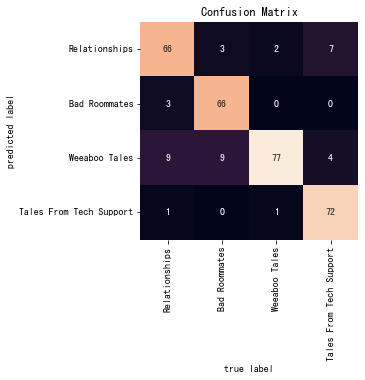

In [74]:
lucem_illud.plotConfusionMatrix(clf, dfTest)

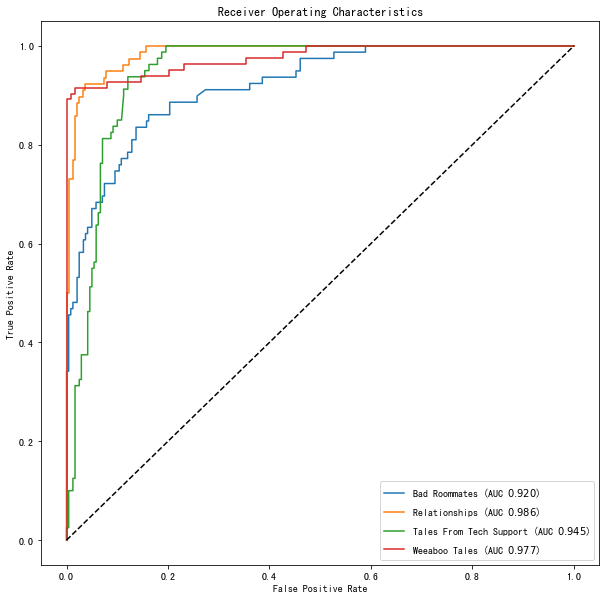

In [75]:
lucem_illud.plotMultiROC(clf, dfTest)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

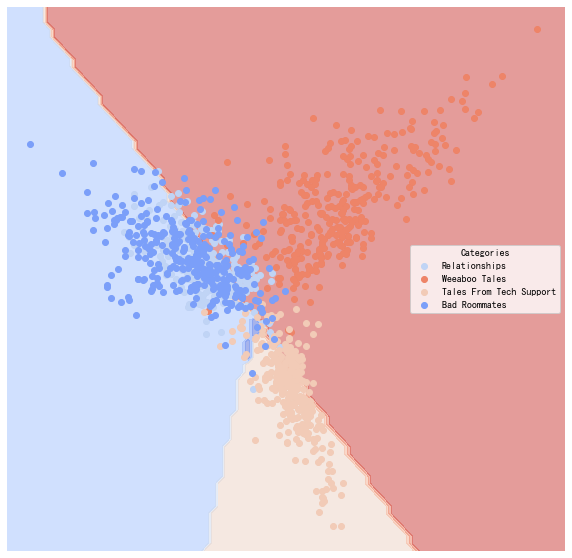

In [76]:
lucem_illud.plotregions(clf, dfTrain)

## <font color="red">*Exercise 2*</font>

<font color="red">Go back through all of the cells above and generate 10 distinct artificial datasets and classify them with all of the available methods. Add a cell immediately below and describe which classifier(s) worked best with which artificially constructed data source and why. Then go through all of the empirical datasets (i.e., Newsgroups, Senate Small, Senate Large, Email Spam) and classify them with all available methods. Add a second cell immediately below and describe which classifier(s) worked best with which data set and why.

<font color="red">***Stretch*** (but also required) Wander through the SKLearn documentation available [here](http://scikit-learn.org/stable/), particularly perusing the classifiers. In cells following, identify and implement a new classifier that we have not yet used (e.g., AdaBoost, CART) on one artificial dataset and one real dataset (used above). Then, in the next cell describe the classifier, detail how it compares with the approaches above, and why it performed better or worse than others.

Here we use AUC to determine which classifier works best with which dataset. 

In [45]:
noise_lst = [0.1, 0.2]
artificial_dataset = []
for noise in noise_lst:
    artificial_dataset.append(sklearn.model_selection.train_test_split(lucem_illud.random(), test_size=.2))
    artificial_dataset.append(sklearn.model_selection.train_test_split(lucem_illud.andSplit(noise), test_size=.2))
    artificial_dataset.append(sklearn.model_selection.train_test_split(lucem_illud.xorSplit(noise), test_size=.2))
    artificial_dataset.append(sklearn.model_selection.train_test_split(lucem_illud.targetSplit(noise), test_size=.2))
    artificial_dataset.append(sklearn.model_selection.train_test_split(lucem_illud.multiBlobs(noise), test_size=.2))

In [50]:
print(artificial_dataset[0][1])

                                            vect  category
852  [0.014637533971523453, 0.23718894945782343]         0
396  [-0.31176394121688245, -0.8845325427994912]         0
494    [-0.571482610314952, 0.19592572052197732]         0
324    [0.3625974669804395, -0.9826660983871869]         0
924   [-0.2978662317023244, -0.1404972180243922]         0
..                                           ...       ...
347   [-0.786692299261627, -0.24597549347349656]         1
341     [0.8072727914718343, 0.8857847940331511]         1
974     [0.8065904912765831, 0.6609085983103575]         0
385     [0.7738497563927924, 0.8112525062200364]         1
719    [0.41522144812406414, 0.8248949396350367]         1

[200 rows x 2 columns]


In [53]:
clf0 = sklearn.naive_bayes.GaussianNB()
clf1 = sklearn.svm.SVC(kernel = 'linear', probability = True)
clf2 = sklearn.svm.SVC(kernel = 'poly', degree = 3, probability = True)
clf3 = sklearn.neighbors.KNeighborsClassifier(5, weights='distance')
clf4 = sklearn.linear_model.LogisticRegression()
clf5 = sklearn.tree.DecisionTreeClassifier()
clf6 = sklearn.ensemble.RandomForestClassifier()
clf7 = sklearn.neural_network.MLPClassifier()
clf8 = sklearn.ensemble.GradientBoostingClassifier()
methods = [clf0, clf1, clf2, clf3, clf4, clf5, clf6, clf7, clf8]

all_scores = {}
for idx, dataset in enumerate(artificial_dataset):
    score_tup = (0.5, -1)
    for i, clf in enumerate(methods): 
        clf.fit(np.stack(dataset[0]['vect'], axis=0), dataset[0]['category'])
        AUC_score = lucem_illud.evaluateClassifier(clf, dataset[1])['AUC'].mean()
        if AUC_score > score_tup[0]:
            score_tup = (AUC_score, i)
    all_scores[idx] = score_tup

all_scores

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale t

{0: (0.5059023609443778, 5),
 1: (0.97009700970097, 0),
 2: (0.9651442307692308, 7),
 3: (0.9396135265700484, 0),
 4: (0.9843525011618365, 0),
 5: (0.5504201680672269, 8),
 6: (0.9298878205128206, 1),
 7: (0.9158653846153846, 6),
 8: (0.885, 0),
 9: (0.944652588587332, 1)}

1. dataset 0 and dataset 5 are generated by random, so none of all 9 classifiers could perform well.
2. dataset 1 and dataset 6 are generated by andSplit with different level of noises. Classifier naive_bayes GaussianNB and linear svm outperform others. These methods are suitable for linearly partitioning data.
3. dataset 2 and dataset 7 are generated by xorSplit with different level of noises. Classifier RandomForest and MLPClassifie svm outperform others. These two methods could handle the indented edge of each section of the dataset.
4. dataset 3 and dataset 8 are generated by targetSplit with different level of noises. Classifier naive_bayes GaussianNB outperforms others. These two datasets have a distinct pattern: a circular area in the middle. So naive_bayes GaussianNB can easily learn the joint distribution of those data points.
5. dataset 4 and dataset 9 are generated by multiBlobs with different level of noises. Classifier naive_bayes GaussianNB and linear svm outperform others. These two datasets have distinct patterns: many clusters. So naive_bayes GaussianNB can easily (they are simple!) partition those clusters with several straight lines. 

In [54]:
dataset0 = sklearn.model_selection.train_test_split(lucem_illud.loadReddit(), test_size=.2)
dataset1 = sklearn.model_selection.train_test_split(lucem_illud.loadNewsGroups(), test_size=.2)
dataset2 = sklearn.model_selection.train_test_split(lucem_illud.loadSenateSmall(), test_size=.2)
dataset3 = sklearn.model_selection.train_test_split(lucem_illud.loadSenateLarge(), test_size=.2)
dataset4 = sklearn.model_selection.train_test_split(lucem_illud.loadSpam(), test_size=.2)
empirical_dataset = [dataset0, dataset1, dataset2, dataset3, dataset4]

Loading Reddit data
Converting to vectors


/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'story'. Check that your pipeline includes components that assign token.pos, typically 'tagge

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'year'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'complaining'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'issued'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'baking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'somewhere'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'telco'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tremendous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'attention'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'awesome'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'causing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grief'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'coder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'college'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'poor'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'starbucks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'compassionate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'caring'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bowels'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'southern'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'swamps'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'semi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'retired'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'declining'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ghostdan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bossman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'typea'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'de----'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '400'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grumbles'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'embarrassing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'taco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mputerstore'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oldboss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'powertrip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whiteintern'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recounts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pizzas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contains'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blocking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kindly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mistyped'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'startup'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'platform'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'corp'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ultravnc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'biggie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'draw'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'howdy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '^^^^^^^^^^^^^^^^^^^^^^^^^^^^^'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gang'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hospices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'community'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aluminium'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'visible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'melting'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'workflow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'slicing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'backends'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deader'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frickin'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sticks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'formats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '.mp4'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'assessments'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'health_insurer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bidder'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'english'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bluetooth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'broadband'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rawkout1337'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pitchforks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roles'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'highschool'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'predecessor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'catastrophic'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'beeing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scrolled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mechanism'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tuxedo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'craptacularly'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abroad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'respective'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'native'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thi--'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chasing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sucks'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sketchy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'm'lady'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hcpb'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shuffle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'playlist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'huffing'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tripled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '270'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumption'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'z.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'soufflé'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'holders'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'telematics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'html5'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'securi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'googles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'celebrated'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2um04'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'company_policy_is_company_policy_part_one/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2uq36h'. Check that your pipeli

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rainfall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'floods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '7:50'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'worlds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scummiest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roommates'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bulimic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'retched'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rented'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alcoholics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'excessively'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'woes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mask'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'waffles'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sixteen](https://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/56zfu5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mooching_molly_part_16/'. Check that your pipeline

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'volleyball'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bumper'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'orchards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fwb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'predictions'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prologue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vouching'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emerging'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ragequit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'diplomacy'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'res'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rooming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'diabetic'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'barbecue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'iraq'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marines'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ya’ll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zoe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'den'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'borrowing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snored'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tazered'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'orderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'monica'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'geller'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'accountability'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '-he'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'phlegm'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'murdered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'housework'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'atmosphere'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bros'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ditches'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'transform'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'maxipads'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whipping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dexter'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'maude'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'elders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'earnt'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abject'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lambs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'infatuated'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '4br'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'baths'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'saudi'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intolerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intitally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '111'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hedge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fertilized'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'planted'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unspecified'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'experts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'translates'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'andy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3months'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mc'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'illness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hud'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snuggling'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scruples'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'consented'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rampaging'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'delegation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sweep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'countertops'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2br1ba'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '~800'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unexpectedly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'viral'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'meningitis'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '570'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'volition'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'symbolically'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'anna'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lisa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'natured'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chipping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'percentages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disorders'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tshirts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quicker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'radiators'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alphapig'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'formed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'occupants'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'live(friend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'duster'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pimp'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'apartment-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'trashes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'excursions'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'philosophy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sparkling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cherubs'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chants'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rastafari'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'guttural'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kudos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bacterial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'freakout'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'parented'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boston'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'plotted'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mums'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ramped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flatmatedom'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'watermelon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'meager'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '11/18'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '50/50'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frugally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '8mths'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wailing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leeeeeeeaaaave'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'meeeeeeee'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sidetracked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'finale'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'suckers'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'workouts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pleaser'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thievery'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'banged'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'litterly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'talentless'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'edition'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prof'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perfume'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yaoi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'population'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'niceguys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brace'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hairstyle'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'classmate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'briefcase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'decal'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carpal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'combinations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hambeast'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weebish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spectrum'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eccentricity'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frizzy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'slender'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'complected'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reminiscing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeab'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prophet'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'godsdebris'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'partake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'loveless'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'watcher'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bookworms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heartbroken'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'headsplosion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hokkaido'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'doki'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'viet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bcb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'imagery'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stifling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'farce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sugarmomma'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'origins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mint'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pedophile'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chorus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'manic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'merge'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mason'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jars'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rainwater'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'neglectful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'person(harsh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intersted'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'back-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'danilla'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sensible'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mod'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'douches'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeabs'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spanned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eventual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/1z0kcy'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'y''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mothafuckas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reeeeeeally'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'instigated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pedophiles'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'twelfth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tanaka'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'york'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hippie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'swaps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'veins'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'villain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snark'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fittest'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'narrator'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wobbles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'homebody'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'poem'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'invention'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'furrows'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lesbians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fondle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'japanime'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'corrupting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'communing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conducting'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://redd.it/5h7n6f'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'miscarriage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'supervising'. Check that your pipeline includes components that

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wincing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dodging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kinkos'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'harambe](http://imgur.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jnsih'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dabbing'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fatpeoplestories'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'plural'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indie'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'japanofile'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nanking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fundraising'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'belgariad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'metalhead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grungey'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'undesignatedoffense'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thelonlon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hardworking'. Check that your pipeline includes components that assi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stereotyping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lisp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vernacular'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vampire](http://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/1kcshl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'how_i_learned_i_am_a_vampire_and_exorcised_some/'. 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'garter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'possom'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oscillations'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cheshire'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'defends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marching'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'writings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token ''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'firsts'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wayward'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dramatists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'extras'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tadaima'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'http://www.reddit.com/r/weeabootales/comments/1sew9q/tsundere_the_yaoi_queen_part_1/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vivid

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mutter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'costumers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uncaring'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fastest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lapping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dmf'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'donald'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frontrunner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nixon'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'momocon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'steampunk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sexed'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/1xkudd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'why_i_left_the_anime_club/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'datemeplz'. Check that your pipeline includes component

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'webbette'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'timberlake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'photo](http://cdn.hollywoodpq.com'. Check that your pipeline includes componen

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disastrous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'class(yes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comprised'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/1izmbg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'danny_and_the_weeaboo_planet_housemate_moving_day/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'danny'. Check that your pipelin

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kyaaa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rejoin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ana'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2ajdvh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stalker_a_weeaboo_tale/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2akm0n'. Check that your pipeline includes compon

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2l'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'backwash'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2ap1fr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'injustice_weeaboo_among_us_a_weeaboo_tale_pt_5/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ladygents'. Check that your pipeli

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comedic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'faraway'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fates'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stalin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'say/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sighting'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/3u27pp/really_weird_things_are_happening_to_me_22f_not/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wowowowow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/4lvz0'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_25f_professor_30m_asked_me_to_go_on_a_date/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'convocation'. Check that your pipeli

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tl;dr**:daughter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'f20'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'm43'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'photographer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'candids'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://m.reddit.com/r/relationships/comments/4vjpo1/my_56_m_daughter_18_f_ha

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/26pydf/my_bf_m25_wont_ask_for_my_hand_and_my_dad_m48_is/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boycotted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotatio

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boyfriend](http://www.reddit.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/34qch1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_22f_boyfriend_25m_is_hiding_all_my_stuff_and_i

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'donating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'propose'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '12.30'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/48ln18/i_27m_want_to_marry_my_gf_25f_of_4_years_but_im/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'a.hole'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation fo

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nephew'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dehydrated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '26f'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'miscarriages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'miscarrying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recuperating'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'latex'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spreaders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bondage'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'derogatory'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grandchildren-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'babysat'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3gqhpq'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_26m_girlfriend_24f_openly_does_not_agree_with/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'downplay'. Check that your pipel

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'http://www.reddit.com/r/relationships/comments/2rbnd1/im_27_m_out_of_town_right_now_my_best_friend_saw/?limit=500'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hospice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS an

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'videographer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'turbulent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'windowed'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'http://www.reddit.com/r/relationships/comments/3nlv34?sort=confidence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://rr.reddit.com/r/relationships/comments/55zq1c/me_26m_with_my_livein_girlfriend_26f_10_years_she/?st=iu45ko64&sh=99d7b298'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmati

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'http://www.reddit.com/r/relationships/comments/1fb0bg/update_i_told_my_wife_i_loved_her/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'entre

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/5cuvee/i_59_m_recently_lost_my_son_26_and_dont_know_how/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'misstated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotatio

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/43pba4'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_23f_boyfriend_28m_of_8_years_says_im_abusive/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'home(i'. Check that your pipeline

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4t5z5t/do_i_20f_tell_the_guy_ive_been_casually_seeing/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'matter-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation fo

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dysmorphia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dysmorphic'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4eftot/my_30m_dog_1m_ate_all_of_my_girlfriends_25f_shoes/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'runners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4m5gwp/me_25f_with_my_boyfriend_25m_of_5_years_is_he/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3cc3vm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_girlfriend_21_f_cheated_on_me_23_m_with_my/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'penetrative'. Check that your pipel

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'np.reddit.com/r/relationships/comments/3ugpj1/me_27_m_with_my_wife_29_f_4_years_im_getting/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'surfaced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/3ccaf3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_43m_daughter_22f_has_started_stealing_to/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unemotional'. Check that your pipelin

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/5g5f6u'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'i_23_m_found_my_girlfriends_23f_fake_instagram/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'i_23_m_found_my_girlfriends_23f_fa

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'peru'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marathons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appeals'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4pzlmo/our_23f22f_brother_26m_has_publicly_humiliated/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dayna'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bounds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'illustrate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'checkstand'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'middleweight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'px90'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pontificating'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '18f'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'demeaning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frighteningly'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/44czp3/hubby_of_10_years_35m_just_told_me_hes_planned_a/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'graig'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation fo

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://www.reddit.com/r/relationships/comments/4j727c/i_22f_am_getting_married_soon_my_mom_had_an/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flamed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for th

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rory'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clara'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bono'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2g7rfe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_injured_wife27f_of_3_years_just_told_me25m_to/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'asparagus'. Check that your pipe

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'normalized'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sundown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'curt'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '29f'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kara'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '33f'. Check that your pipeline includes components that assign token.pos, typically 'tagg

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'undecided'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indigent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'qualifies'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/2sak4u'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'got_into_a_verbal_argument_with_my_30f_sil_38f/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'underplaying'. Check that your pip

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'night(but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cultish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'duggars'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'orgininal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments/51zki0'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'my_grandmother_70f_threw_my_13m_homework_in_the'. Check that your pipeli

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'op](http://redd.it/3dijz7'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obligation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adoptive'. Check that your pipeline includes components that 

Loading data for: comp.sys.mac.hardware
Loading data for: comp.windows.x
Loading data for: misc.forsale
Loading data for: rec.autos
Converting to vectors


/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rgb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'capasitor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3l0218'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'powervision'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'compatability'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'envisio'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cpd-1304'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '640x480'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '800x600'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comp.sys.mac.advocacy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'header'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pnews'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '415'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '961'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '0911'. Check that your pipeline includes components that assign token.pos, typically 'tagg

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'distinctions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '7000'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'excerpts'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'c5ngii.bgx@news2.cis.umn.edu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bunt0003@student.tc.umn.edu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'monthian'. Check that your pipeline inclu

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appriciate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'postitive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'serverdict'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'speculated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'groundbreaking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '98601s'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'staging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fastcache'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'optimum'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '13"rgb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dgr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spidery'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'seagates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'constitutes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lp240s'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cpd-1320'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mac<->vga'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '335'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '185c'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appearence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'macleak'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'greg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'decipher'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'purchasers'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preferrable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'syncronos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tia'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tek'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xtici'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xcms'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2.x'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shenk@math.gatech.edu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sls'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'part5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1993/04/04'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '119'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grape@nswses.navy.mil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sun4/470'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'screen:0.0'. Check that your pipeline includes components that assi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'equiv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kludgy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xraisewindow'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ascension'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'red(gets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sprite(mouse'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'part3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xstuff@expo.lcs.mit.edu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5a'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chongo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'landon'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'part2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'screendump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xpr'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'devloping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'multiscreen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '0,0'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unix:0'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'foo:0'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'localhost:0'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'drag&drop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'css'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sincerly'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'part1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'redistribute'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lbx'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xv_depth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'g'day'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tasking'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pelkey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '509)375'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1.28'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '93/04/02'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '12:41:12'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'diff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '04/05/1993'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '23:00'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aerea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'applikation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'part4'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'multipart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'x/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '@(#)mkentry.c'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '8859'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xsession'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'supposing'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hourglass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subpart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crosswire'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1.25'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '15:58:08'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'border_pixel'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'm.sc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'simula'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'miranda'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'configurenotify'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dbohdal@jaguar.ess.harris.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'execv'. Check that your pipeline includes components

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1993/4/15'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'handbook'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'loukides'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '8.40'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1.05'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '6.30'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2.49'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pkg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'economy'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'backdraft'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tides'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'memphis'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mislabled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'learnd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'waite'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cpc3@po.cwru.edu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reapir'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'async'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'norman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rockwell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1960'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ie-"as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boughten'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '056'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'okidata'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'centronics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'printhead'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '~~~~~~~~~~wanted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '50z'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preferr'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zenith'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'z-248'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'z-386/25'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'readout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'checkers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '200cd'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'luxman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'r-351'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'onkyo'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pwr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '350.00'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '252'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'juno'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '60-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uniden'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alamo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '29th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dustcovers'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sonics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'addictive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '743'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'union/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'payoff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sae'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'drivability'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bell@plains.nodak.edu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '^^^^'. Check that your pipeline includes components that assign 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rotors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grooved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hondas'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overheated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'robbers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ceaseless'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yeah-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'father-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gourd'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'militech(tm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'militech'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '-erich'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deterrent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'miscalculated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perpendicular'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'glove'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'concealed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'concealing'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wagons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hearse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lt1'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'peddel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'repairman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overpasses'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'plannig'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '23,000miles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'occassionaly'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'v16'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'glitches'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'labour'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pedestrian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fencing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wackos'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gtz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gsr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'integras'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'junctions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'localities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nonexistant'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'workable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'restate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pea'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'swarms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unlawful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roadmarkings'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mgs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '95k'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thati'. Check that your pipeline includes components that assign token.pos, typically 'tag

Loading senate data
Converting to vectors


/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obama'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'taxpayers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'barack'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3044'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '6049'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'republicans'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ramos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'horta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'timor'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'madam'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brutality'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'qaeda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'resurgence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'briefing'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'forfeiture'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adequacy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'exercised'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'absentee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'meghan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'keck'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'modernization'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2284'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'approving'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ravitz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shana'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marchio'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'expedite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'misdiagnosed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reauthorization'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deborah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'platt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prudhoe'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'redeployed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disparities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'corresponded'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1418'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'anonymously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'currying'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1519'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adjourning'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nonproliferation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'verasun'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'orm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'districts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'revolutions'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'designate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'upholding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jena'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cadre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'regenerated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lieutenants'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mankind'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uranium'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'iaea'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1874'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '63rd'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'undercover'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'checkpoints'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '22202'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wilhoit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'travesties'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'splashed'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yucca'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '528'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'geothermal'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'umbilical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crusader'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'achilles'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mineta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appropriation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wv'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gleischman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bolstering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'judd'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'discloses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adler'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'planetarium'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'referrals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortchange'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '7125'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'secretariat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'seekers'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cataclysmic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'superdome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'paramedics'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'slogan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subsidized'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wertheimer'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wilma'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kiowa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3322'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'courtney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clinicians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'winkenwerder'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '846'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'simplification'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fleeced'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'southwick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gays'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'plaintiff'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'laud'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lauding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'redoubled'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'malaria'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'insecticides'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'antimalarial'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shalala'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'passantino'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perkins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'paducah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appointing'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3221'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cutbacks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bails'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quai'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'orsay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '75351'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'commends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tripling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'geological'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '391'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prosthetics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'examiner'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tivo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kidzone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perpetuity'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yousuf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'raza'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gilani'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aoc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wynne'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'the183rd'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overcrowded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appendicitis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cynically'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'belvidere'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'impervious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ibrahim'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'debunked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'madrassa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'espousing'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'necessitates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'misclassified'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'classifies'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'palestine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obamas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5175'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jag'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '489'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cjs'. Check that your pipeline includes components that assign token.pos, typically 'tagge

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tithing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'creditors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'baptist'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'naperville'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'merkin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'currie'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5373'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2551'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whims'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'showcased'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perseverance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'diaspora'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '52nd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '61265'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1217'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'videotapes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'imperfections'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'triumphed'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'diversify'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hrsa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'repayments'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conocophillips'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mulva'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roxana'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'canopies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fy2005'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'incentivizing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'revitalize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nlcfs'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '261'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bottling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reintroducing'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'syracuse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'canandaigua'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'irritability'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'libyan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dctoday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'senates'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'restaurateurs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'foodlink'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alfred'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spellings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'assailed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fordham'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bowman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nyri'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'interconnect'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aba'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'symposium'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'convening'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boater'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hempstead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'antwerp'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'instituting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adviser'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lute'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nrcs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ccpi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'formers'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'colchester'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spitzer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gillibrand'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'montrose'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'underlines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overstressed'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'parnaz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'azima'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'woodrow'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gendarmerie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kamenets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'podolsk'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1782'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ceremonies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1932'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'semo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'surpluses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vaccinations'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aiding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mcclellan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cynthia'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crosshairs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brunswick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'beefing'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'distrust'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'holsingers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kentuckys'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'borough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adolfo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carrion'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '518'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'planbpetition'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'agjobs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'staunchly'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'akwesasne'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'essex'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roi'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jamaica'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'accumulates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'replenished'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'busalacchi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cino'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'geddes'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kathy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jimino'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spano'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'copycat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hijackings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'danbury'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'berc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ffe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'incite'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'amproud'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'measureshave'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sbill'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'asp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pallet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'embarkation'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '914th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '314th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '101st'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blakey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reevaluation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '20591'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gero'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'superb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1930'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'phyllis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rein'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'psc'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'granddaughters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'electing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kurdish'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quadrennial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'congresss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'admirals'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blunders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vantage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'excesses'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'esrb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'age17'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appropriateness'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '20551'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ffiec'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'originators'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'champlain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '400th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'voyages'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'relinquished'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5100'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'articulation'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sybil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sickle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thalassemia'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'southampton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mermaid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ponquogue'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cooney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dismaying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'exxonmobil'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'woundedwarrior'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ambient'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'simonds'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'beaulac'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ncrc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cra'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'segal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '725'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'incarcerating'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1111'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uncorroborated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '531'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rosenberg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'censoring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'coarsening'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cropsey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'renown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'painters'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '193'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '053'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '024'. Check that your pipeline includes components that assign token.pos, typically 'tagge

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '298'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '537'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'offsetting'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reallocate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heeding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sprawl'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sardines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'straphangers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alianza'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '30329'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'untried'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'incidental'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'remobilizing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'topography'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'remobilized'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'beautifying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'covenant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'harlem'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'designates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'enacts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'balloting'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nicholsons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'smoothing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shays'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ombudsmen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sherry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'polluters'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stoning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'onlookers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perpetuated'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uncontrolled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carcinogenic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'trichloroethylene'. Check that your pipeline includes components that as

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crewmember'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crewmembers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unied'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whistleblower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aberrancies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'billings'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'counterinsurgency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sheikhs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'occupier'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scaap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'detaining'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'neutrality'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cabins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'daunted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sensitively'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'microelectronics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'camm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rands'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dreamers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'springtime'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'floodwater'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hypres'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'holographics'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reallocation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'umte'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'valleys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1844'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inductees'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'policyholder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'superintendent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dinallo'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3678'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'countermeasure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mrc'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chaite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lymphatic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'johanna'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'circumvented'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'homestudy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'permanence'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wegmans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wegman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wallkill'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'edelman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'impugned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emboldens'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dwindling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'supervisory'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nonfarm'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'upton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gluon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'plasma'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nyc2012'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'paralympians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'medalists'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rocco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'defazio'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'silvio'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brokered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wenzhong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '20008'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inhibits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '759'. Check that your pipeline includes components that assign token.pos, typically '

Loading senator: Klobuchar
Loading senator: Kyl
Loading senator: Kerry
Loading senator: Kohl
Loading senator: Kennedy
Converting to vectors


/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fergus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'traci'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kromenaker'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ransavage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'immigrations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dwi'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'graemes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'drains'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'polytraumatic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'woodruff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'palo'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heffelfinger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wasington'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prosecutions'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'repairit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fy09there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dayit'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'criticswho'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'agebelieve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'denmarkwhere'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dyrud'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'paralyzing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'petzel'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '9043'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'warroad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'baudette'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ffga'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ftas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'arteries'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'filtration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'microbes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'meteoric'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '063'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ramsey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '656'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thunderhawk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blandin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wellstones'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'forprogress'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ramstads'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fostered'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '254'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dedicates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'biobusiness'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'toybox'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'atts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'verizon'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'windfall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'remedied'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'formularies'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5045'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'refinances'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rosenker'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'removalincluding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'californias'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ridgedale'. Check that your pipeline includes components that assign 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'milligram'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'arteriosus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'drugmaker'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whipple'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '55111'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'parkinson'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schafers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mppa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preissler'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'upi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'foothills'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shenandoah'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fundamentals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conoco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overbilled'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flagrantly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '8571'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hodge'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weatherization'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weatherize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mainers'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '9/11'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wahhabi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'islamist'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wildfire'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2696'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eri'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1,184'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zuni'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '26.5'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '40.1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '6.97'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '45.4'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronado'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'u.s.-mexico'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recreationists'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '288,000'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '337,000'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '315,000'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'swoops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'luntz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'estates'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kempthorne'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reallocates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overtax'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'galling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pearls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'barbs'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overstays'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lawbreakers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '14,500'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '484'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'widowers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lofty'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 's.r'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'likened'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'christiansen'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conveyance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conveyances'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'riverfront'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pre-1970s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'attackers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weaponize'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'porosity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zeroes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '54.00'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'odious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jeanne'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'charade'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reflections'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'springerville'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'politicos'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ukraininan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'patters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'expulsions'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3711'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5.83'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sadden'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flexibly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perpetuate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gentlewoman'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'complaisance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'soundbites'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overthrow'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'refocused'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '85.1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '81.7'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'slade'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'renteria'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bettenhausen'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '199th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hallowed'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mogollon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3058'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'i]nformation'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '921'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'syrian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5,500'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nascar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'earnhardt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tippin'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ecologically'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'headwaters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sublime'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'naco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lukeville'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'somerton'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fiscal-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'circuited'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'p.l'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'decisiveness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cutler'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'i]t'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '7130'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'salutes'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'outpaces'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'geologists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'anwr'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contrasts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'd]ue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'doubtless'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cognizant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'implacably'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subjugated'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scidd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gravitas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'banker'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'renegotiate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'colombia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 's.30'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jurists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pediment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ovc'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '30pm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dobriansky'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wirth'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hanscom'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'privatized'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stoppages'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subtracting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'illogical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tenured'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tenths'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'familiesusa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bureaucrat'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mushroomed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'walesa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'humanitys'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cayer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'funerals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'headstones'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'milford'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'edmar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alves'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bumbling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2970'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pearson'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rainforest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'borneo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sumatra'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lethality'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intermix'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rooftop'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jennings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disparage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'andover'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'annouce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nmtcs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'businesslinc'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ndea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prek'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tinker'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mountaintop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mountaintops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obliterating'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'statesmanship'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'primacy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disdained'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nuevo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'herald'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hacia'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'graceful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vigilante'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'epitaphs'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roadless'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'backdated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'backdating'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rubberstamp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mistruths'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dunk'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'magnifies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'benning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'platoon'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nullified'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'falkenrath'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wickman'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nitzewho'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'institutionunderstood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'doctrines'. Check that your pipeline includes components that assig

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'irrepressible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'garrisoned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mismanaging'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abdication'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'coalitions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'restive'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reconsiders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sates'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ahmadinejads'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cruelest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'revisionist'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '981'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hockfield'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '853'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'barre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'knightville'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contending'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'calamity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ennobling'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wicks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overoperations'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inquirer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'equivocal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jaafari'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kenyon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gambier'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5592'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'decommissioning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vermonter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brightwood'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wachusett'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'asquino'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fomentar'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'profiteers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'custer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overcharging'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'barretts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1775'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'middlesex'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'selma'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'karyn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brazenly'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unraveled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preoccupied'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'liberalized'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'amass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rigors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vecchione'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sheehan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ralston'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'professes'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aultz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'milton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mettille'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'criticisms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quantifies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'babara'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aimless'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'questionably'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frittering'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dugan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'milken'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dugans'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'orthodoxy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'capitulated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'falwell'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'strenthen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sizable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bandeira'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '35th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tonkin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'saigon'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'musharaff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'iftikhar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nawaz'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'soulless'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'endorsers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'islip'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vuelva'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'involucrar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'latinoam'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indecision'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recrimination'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pluralistic'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'telegram'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gazette'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'polarized'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wahsigton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'skirmish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eases'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '401k'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deferrals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emanuels'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jawboning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fudging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'singularly'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'denomination'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'changeits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'andmost'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'celtics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'setti'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'greats'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'equifax'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stanfield'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gambill'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scrimp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sioux'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spdc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tripartite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nld'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reshaped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mobilizations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'federalizing'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'liebergott'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overseers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'locklear'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '010'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emory'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rollins'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'm240'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mk19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tarred'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '103rd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'warthog'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '141b'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flir'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'imagers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hhi'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tiecon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'keirestu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hynes'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vinylidine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chloride'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'attenuation'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'campaigned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'joyous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'graciousness'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'goalto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'debateand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sculpted'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ladish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cudahy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pliant'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sirius'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ipods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'karmazin'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'strenghtens'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'melamine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cfed'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zablocki'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rehabilitations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'seniorcare'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'suc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '018'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pesticide'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'artisanal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'febrary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'horeb'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jcct'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dunlop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dunlopthe'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'breakwater'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rationalizations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unimagined'. Check that your pipeline includes components that assign 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'becker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'arco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inelasticity'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hac'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '440th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vexing'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'infringed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overqualified'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'holz'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'outlive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'novemeber'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'glifwc'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '4636'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blanco'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'payoffs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pcma'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'csfp'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unreported'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'outweighs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uncollected'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'formalizes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snuffed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unscreened'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cowag'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carmona'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pere'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disagreeable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'desecrate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'decals'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eaton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'switchboards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'caledonia'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'centerfile'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'caving'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'winthrop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'superfluities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'necessitieswe'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hollowed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thaleia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'katina'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'commissionremarks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hufstedler'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inequitably'. Check that your pipeline includes components that assig

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'freeland'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'buffeted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rekindle'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'msac'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rightness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subsiding'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'achievers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'actsenators'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alexanderfindings'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sectarianism'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'provocation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contingences'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'elaborations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'compulsory'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bolar'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gerrys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mccarthys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'masterminding'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'succumbs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'underlies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alleviated'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mckeons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'actthe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'consultancy'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'solow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stiglitz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clive'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '234c'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'standardswith'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'penaltiesto'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'seigenthaler'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'antonia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hernandez'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'incapacitated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'insolvent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weighted'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subordinating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contemptuously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'octogenarian'. Check that your pipeline includes components that assi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'drf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'materially'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'confine'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1868'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'outlawing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gamut'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ablaze'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'devolving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'concurred'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'impeached'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tyco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overcharged'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'predetermined'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'draftees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'floundering'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'olmstead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sheppard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brokenyear'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'domenicis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'syndicates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carmonas'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'choicesbetween'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2429'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marianas'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mshas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'massachusettls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mattapan'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crouch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ayusa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'goals1'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deportations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'depresses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'legalizing'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gavel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'meade'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mortgaging'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'problemthe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nhis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'placements'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rmc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reportbetter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'firsta'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'revisits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'actkey'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'h2c'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'precluding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'admissible'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'advantaged'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aver'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nonunion'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'workersimmigrant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nativewould'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'naacps'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'georgias'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bermans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schlozman'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vietcong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lulled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shies'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'labored'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'diegos'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'suze'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'orman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'draut'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'samaritans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disparages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'monthscant'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'meltzer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'productsthis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'smokeless'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'colemans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hazmat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'agawam'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'underfunds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'assassinated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'transactionsblock'. Check that your pipeline includes components that assi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'northshore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'underfund'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'assistancewashington'. Check that your pipeline includes components that assi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'forwardly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'celebre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'devlin'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'operatenow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'exigent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adage'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'paratroopers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gunned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dishonorably'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cherubino'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'treatmentand'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'naindz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flattened'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sauerbrey'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'depicts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'croteau'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'streetworker'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'knell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'johnstown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deceiving'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'caplin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'benefactor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'johnsons'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cohesiveness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fukuyama'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'protracting'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blockage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cambria'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'penitent'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'circumstantial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roundups'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'underpay'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roussel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rescues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'superintendents'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pdbs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jarrett'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3529'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'manadel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jamadi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'faucet'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'workersbut'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hereinafter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'attestations'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'landrigin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'markers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nonmalignant'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'massachusettswashington'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2633washington'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2006honorable'. Check that your pipeline includes component

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oscar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'handlin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'festered'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sheetsince'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '592'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'precis'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedyat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tunneljune'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oneils'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'breifs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'senatewho'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intelligencevoted'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indoctrinate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aquinas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vandenberg'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'muchissimas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recibir'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'premio'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aquaculturists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '20250dear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'noninsured'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2007section'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'summarythe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rightssection'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'washingtonpost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dyn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ar2006122901066'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preschoolers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bewildering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sightedly'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'homemakers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cmdr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bowens'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ramparts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'illega'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unorganized'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hurd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mcnary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'actincreasing'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mahony'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ache'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'remitting'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'housewashington'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kerrysusan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reedchristopher'. Check that your pipeline includes components that ass

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'controversiesabout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'antidepressantsabout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vioxxabout'. Check that your pipeline includes components 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unapologetically'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wilkerson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stooping'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vindictiveness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'declassifying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'maoa'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mccardle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nettlesome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'criticalthe'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'torpedoes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'languishes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'loza'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1700s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'herding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'primes'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mlk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rolfingwe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedyits'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nunez'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nez'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nunezwhat'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'miotcra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'press_office'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'govjennifer'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cellucci'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'finneran'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bioteach'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ltr_reid_121207'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aumf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'powersthereby'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shrivers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'childrenmaria'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'robertalso'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '82d'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fishback'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'exertion'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'backers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'donohue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sojouners'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tonya'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ceasars'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2033'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brutalize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sinatra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '78th'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'officio'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'berths'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'accommodates'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'keene'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'seemiller'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1651'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'opportunitya'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'democracyis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stoolelementary'. Check that your pipeline includes components that assig

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'asg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spruce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tortfeasors'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xdr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2007via'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mailjulie'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'masenator'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deutsche'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ccais'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'joblessness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hobble'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adelphia'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marbled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'irrefutable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'diehard'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedyfloor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'watchlists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'griffith'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'completers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fleming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'buehlmann'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dedham'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'staking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'doi'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unreformed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'misleadingly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '0237'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brooking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'senatory'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indemnification'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'undersigned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ahps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'naic'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subsuming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lopsided'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'accede'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'favorability'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'swirled'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hgtv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ruggedness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lighthouses'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'transacts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'courtc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leaflet'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lsu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'remainedmost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tammanys'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deferential'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scurrilous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mellot'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mbna'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fatema'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hosseini'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heyday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'harvards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'penal'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jan84'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'feb191'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mar56'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'immigrationpeople'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'balancewe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'necessaryno'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'educationmany'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'programswe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'actdespite'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aracoma'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clast'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unfertilized'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sakson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hollingsworth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bierman'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'libertiesthe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'persisting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'michigans'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'incurrent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'battter4ered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oppressor'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frittered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preferring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bunting'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prouder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '600th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'algerian'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'generaldocuments'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sensitivewh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thisif'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mistreat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schoolyards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'feverishly'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2693'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snatching'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'capades'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hideout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'musharaf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fightal'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2849'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mullen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '200510'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'animates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'triggerssecure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'compartments'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rnep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kiloton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emplacement'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comport'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shakedown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'consenting'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'militarized'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emigrate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'signifies'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'miis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'astra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aaas'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yearfor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ingarman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '10ths'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'promulgating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'purges'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obliterate'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2803'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedychildrens'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'supportnot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'royer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scavenge'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fevers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cholera'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'backgroundthe'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'failedfailed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yearsbecause'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overestimate'. Check that your pipeline includes components that assign 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'americanseven'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'physicianswant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'proliferate'. Check that your pipeline includes components that assig

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'baugh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emigrant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emigration'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thatevery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'beringer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deliveryid'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'societyprimarily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'individualsto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'months11'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'iop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'iops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pusey'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'slm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dunlap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2007tim'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'turnand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'courtand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lawdramatically'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oig'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'auditreports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'a07f0017'. Check that your pipeline includes components that assign token.pos, ty

Loading Spam
Loading Ham
Converting to vectors


/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whitening'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ovcnd'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'haberdar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'olun'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'think!32482'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jp?b?gyrcjdckocrfjegkyirije4lmyvpjvwlbce8jtclzyvzgyhk?='. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '12021'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ceviri'. Check that your pipeline in

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'iubrq'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'anticaipting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ptjti'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gamespot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lionheart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pgsql'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reenactor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leica'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'configurator'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lili'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nile'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'postmortem'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2002.06.00.00'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'defnitions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oscom'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'apt.conf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'k3b'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nessus'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xtreme'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'histograms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'macnet'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dither'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'paddick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tate'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xosd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dvd::rip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'check,1.67,1.67.2.1'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pyzor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mx'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unconfirmed.dsbl.org'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'curried'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'classifier'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hammie.py'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dreadlocks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'painfree'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'defaced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nyt'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'evolvable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lego'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'harpsichord'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mime'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rambus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gecko'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dubyadubyadubya.dubyaspeak.com'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rambos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'googlenews'. Check that your pipeline includes components th

In [55]:
all_scores = {}
for idx, dataset in enumerate(empirical_dataset):
    score_tup = (0.5, -1)
    for i, clf in enumerate(methods): 
        clf.fit(np.stack(dataset[0]['vect'], axis=0), dataset[0]['category'])
        AUC_score = lucem_illud.evaluateClassifier(clf, dataset[1])['AUC'].mean()
        if AUC_score > score_tup[0]:
            score_tup = (AUC_score, i)
    all_scores[idx] = score_tup

all_scores

{0: (0.9938711540237706, 1),
 1: (0.932906180680138, 7),
 2: (1.0, 6),
 3: (0.9950460448258195, 6),
 4: (0.8186759239778385, 0)}

1. dataset 0 is the reddit dataset. Linear svm perfoms best. This method could easily partition those clusters with several straight lines if the clusters have clear boundries. 
2. dataset 1 is the NewsGroup dataset. MLPClassifier outperforms others. The boundries between each cluster of this dataset is not clear, so methods like MLPClassifier, which has non-linear layers to handle complex boundries, can perform well. 
3. dataset 2 is the small Senate dataset.RandomForestClassifier outperforms others. The boundries between each cluster of this dataset is not clear, so methods like RandomForestClassifier can perform well. 
4. dataset 3 is the large Senate dataset.RandomForestClassifier outperforms others. The reason is the same as above. 
5. dataset 4 is the spam dataset. Naive bayes GaussianNB outperforms others. But I don't think the result means anything. This is a super unbalanced dataset. 

In [89]:
from sklearn.ensemble import AdaBoostClassifier

clf_art = AdaBoostClassifier(n_estimators=100, random_state=42)
clf_art.fit(np.stack(artificial_dataset[1][0]['vect'], axis=0), artificial_dataset[1][0]['category'])
AUC_score_art = lucem_illud.evaluateClassifier(clf_art, artificial_dataset[1][1])['AUC'].mean()
print('artificial dataset: 1, method: AdaBoostClassifier, score: {}'.format(AUC_score_art))

artificial dataset: 1, method: AdaBoostClassifier, score: 0.9550455045504549


Adaboost is an adaptive method. So the number of estimators could impact its performance. But it is not without limitations. I think it may only be able to handle dataset with simple patterns. It performs badly at 'XOR' like dataset(In fact, only some complex classifiers like RandomForestClassifier and MLPClassifier can handle 'XOR' like dataset). And increasing the number of estimators could not always increase the AUC score.  

In [86]:
clf_emp = AdaBoostClassifier(n_estimators=100, random_state=42)
clf_emp.fit(np.stack(empirical_dataset[0][0]['vect'], axis=0), empirical_dataset[0][0]['category'])
AUC_score_emp = lucem_illud.evaluateClassifier(clf_emp, empirical_dataset[0][1])['AUC'].mean()
print('empirical dataset: 0, method: AdaBoostClassifier, score: {}'.format(AUC_score_emp))

empirical dataset: 0, method: AdaBoostClassifier, score: 0.9308801137111762


Using many weak estimators enables Adaboost suitable for classifying many datasets. So it can have relatively high AUC score in many cases. But it seems that it can not outperform simple methods on simple datasets or when the dataset is unbalanced. 

# Clinton / Obama Press Releases

We often will not have nicely prepared data, so we will work though the proccess of cleaning and structuring in more detail here:

While the Clinton and Obama Senatorial Press Releases are not hand-coded, we can imagine that we have been given a stack of such press releases, but lost the metadata associated with which senatorial office issued which. If we label a few of them, how well can our classifier do at recovering the rest? 

In [ ]:
ObamaClintonReleases = pandas.read_csv('../data/ObamaClintonReleases.csv', index_col=0)

I'm pretty sure that you're all familiar with pandas, but, just to clarify: why do we use pandas here? pandas is a Python library which is widely used for analyzing and wrangling data. In particular, pandas loads data and creates data frame, a Python object that looks familiar to us (since it looks like a excel table) and easy to work with. So, using pandas.read_csv function, we take in the csv file and convert it into a data frame. 

In [ ]:
type(ObamaClintonReleases)

It's a DataFrame! and it looks like this:

In [ ]:
ObamaClintonReleases

Neat! Let's turn the 'targetSenator' column into a binary category variable.

In [ ]:
ObamaClintonReleases['category'] = [s == 'Obama' for s in ObamaClintonReleases['targetSenator']]

Tokenize and normalize

In [ ]:
ObamaClintonReleases['tokenized_text'] = ObamaClintonReleases['text'].apply(lambda x: lucem_illud.word_tokenize(x))
ObamaClintonReleases['normalized_text'] = ObamaClintonReleases['tokenized_text'].apply(lambda x: lucem_illud.normalizeTokens(x))

Let's split the data into training data and testing data.

In [ ]:
holdBackFraction = .2
train_data_df, test_data_df = sklearn.model_selection.train_test_split(ObamaClintonReleases, test_size=holdBackFraction)

In [ ]:
print(len(train_data_df))
print(len(test_data_df))

## Logistic Regression

First, let's try with a logistic regression, which may be familiar to you from statistical methods classes. First, we must turn the training dataset into a tf-idf matrix (`lucem_illud.generateVecs()` will help with this but for now we are doing it the long way):

In [ ]:
TFVectorizer = sklearn.feature_extraction.text.TfidfVectorizer(max_df=100, min_df=2, stop_words='english', norm='l2')
TFVects = TFVectorizer.fit_transform(train_data_df['text'])

The core function here is TfidfVectorizer, which takes a collection of raw documents and turn them to a tf-idf matrix. Just to recap: tf-idf means term frequency-inverse document frequency, a statistic (or, more precisely, a product of two statistics, term frequency and inverse document frequency) that shows the importance of a term vis-a-vis documents. TF, or, term frequency, counts how many times a term is used in a document; IDF, or, inverse-document-frequency, measures common or rare a term appears across documents. 

Let's look at three parameters of TfidfVectorizer: max_df = 100, min_df = 2, and norm='l2'. What do those parameters mean? 

(1) max_df = 100

Here, we specified a thredhold of 100, and the terms that have a document frequency higher than 100 would be ignored.

(2) min_df = 2

We specified a lower bound, 2, and the terms that have a document frequency lower than 2 will be ignored.

(3) norm = 'l2'

This parameter is about vector normalization. In machine learning, we commonly normalize vectors, i.e., change the length of vectors and turn them into a unit vector, before passing them into algorithms. There are various ways of normalizations, and this parameter specifies how we normalize vectors. Here, we set the norm to l2, in which case, we normalize the vectors such that squares of vector elements sums to 1. Alternatively, we can set it to l1, in which case the sum of absolute values of vector elements, not the square of vector elements, is 1. 

fit_transform() literally fits to data and then transform it. So, fit_transform() is just a combination of two steps--(1) fitting parameters to data; (2) then, using the vocabulary and document frequencies learned by fit(), transforming documents into document-term matrix. So, it's the same as fit followed by transform. 

Note that we can use the CountVectorizer instead, which simply produces a matrix of word counts.

In [ ]:
TFVects.shape

We can save this in the dataframe to make things easier

In [ ]:
train_data_df['vect'] = [np.array(v).flatten() for v in TFVects.todense()]

Looks simple, but we need to know what todense() does here. todense() returns a dense matrix representation of the matrix. Why do we need this? As you can see above, the TFVects, a document-term matrix, has 11349 columns, and this matrix is sparse, in the sense that it is comprised mostly of zeros. Dense matrices, in contrast, are the matrices that are comprised of mostly non-zeros. Then why do we make sparse matrices into dense ones? Because zero values don't contain important information but take up so much memory.

In a regression, we cannot have more variables than cases. So, we need to first do a dimension reduction. First, we will approah this with PCA. You have previously seen this in week 3. Here we are not concerned about visualization, but rather classification and so all principal components are calculated. Watch out: we have to use `stack` not `sum` for combining the vectors. We note that you could also use topic loading and embedding dimensions as featured variables.

In [ ]:
pca = sklearn.decomposition.PCA()
reduced_data = pca.fit_transform(np.stack(train_data_df['vect'], axis=0))

We can store the PCA space vectors in the dataframe too:

In [ ]:
train_data_df['pca'] = [r for r in reduced_data]

Visualization in 2D:

In [ ]:
fig, ax = plt.subplots(figsize = (10,10))
ax.axis('off')
pallet = seaborn.color_palette(palette='coolwarm', n_colors = 2)

#Plot Obama
a = np.stack(train_data_df[train_data_df['category']]['pca'])
ax.scatter(a[:,0], a[:, 1], c = pallet[0], label = "True")

#Plot not Obama
a = np.stack(train_data_df[train_data_df['category'].eq(False)]['pca'])
ax.scatter(a[:,0], a[:, 1], c = pallet[1], label = "False")
    
ax.legend(loc = 'upper right', title = 'Is Obama')
plt.title('True Classes, Training Set')
plt.show()

PCA cannot distinguish Obama very well. Let's perform a screeplot to see how many Principal Components we need.

In [ ]:
n = len(train_data_df)

fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize = (16, 5), sharey=True)

eigen_vals = np.arange(n) + 1
ax1.plot(eigen_vals, pca.explained_variance_ratio_, 'ro-', linewidth=1)
ax1.set_title('Scree Plot (Full)')
ax1.set_xlabel('Principal Component')
ax1.set_ylabel('Proportion of Explained Variance')

eigen_vals = np.arange(50) + 1
ax2.plot(eigen_vals, pca.explained_variance_ratio_[:50], 'ro-', linewidth=1)
ax2.set_title('Scree Plot (First 50 Principal Components)')
ax2.set_xlabel('Principal Component')
ax2.set_ylabel('Proportion of Explained Variance')


eigen_vals = np.arange(20) + 1
ax3.plot(eigen_vals, pca.explained_variance_ratio_[:20], 'ro-', linewidth=2)
ax3.set_title('Scree Plot (First 50 Principal Components)')
ax3.set_xlabel('Principal Component')
ax3.set_ylabel('Proportion of Explained Variance')

plt.show()

Let's choose the first 10 pricipal components as our covariates.

In [ ]:
train_data_df['pca_reduced_10'] = train_data_df['pca'].apply(lambda x: x[:10])

Now we fit a logistic regression to our data.

In [ ]:
logistic = sklearn.linear_model.LogisticRegression()
logistic.fit(np.stack(train_data_df['pca_reduced_10'], axis=0), train_data_df['category'])

Let's see how the logistic regression performs on the training dataset from which we develop the model. Unfortunately, the mean accuracy is only about 64%.

In [ ]:
logistic.score(np.stack(train_data_df['pca_reduced_10'], axis=0), train_data_df['category'])

How does it perform on the testing dataset, which we "held out" and did not use for model training? We need to repeat all the steps on the testing data, but without retraining:

In [ ]:
#Create vectors
TFVects_test = TFVectorizer.transform(test_data_df['text'])
test_data_df['vect'] = [np.array(v).flatten() for v in TFVects_test.todense()]

#PCA
reduced_data_test = pca.transform(np.stack(test_data_df['vect'], axis=0))
test_data_df['pca'] = [r for r in reduced_data_test]
test_data_df['pca_reduced_10'] = test_data_df['pca'].apply(lambda x: x[:10])

#Test
logistic.score(np.stack(test_data_df['pca_reduced_10'], axis=0), test_data_df['category'])

Slightly poorer. How about using more dimensions (40)?

In [ ]:
train_data_df['pca_reduced_40'] = train_data_df['pca'].apply(lambda x: x[:40])
test_data_df['pca_reduced_40'] = test_data_df['pca'].apply(lambda x: x[:40])

logistic.fit(np.stack(train_data_df['pca_reduced_40'], axis=0), train_data_df['category'])

print("Training:")
print(logistic.score(np.stack(train_data_df['pca_reduced_40'], axis=0), train_data_df['category']))
print("Testing:")
print(logistic.score(np.stack(test_data_df['pca_reduced_40'], axis=0), test_data_df['category']))

Or still more (100)?

In [ ]:
train_data_df['pca_reduced_100'] = train_data_df['pca'].apply(lambda x: x[:100])
test_data_df['pca_reduced_100'] = test_data_df['pca'].apply(lambda x: x[:100])

logistic.fit(np.stack(train_data_df['pca_reduced_100'], axis=0), train_data_df['category'])

print("Training:")
print(logistic.score(np.stack(train_data_df['pca_reduced_100'], axis=0), train_data_df['category']))
print("Testing:")
print(logistic.score(np.stack(test_data_df['pca_reduced_100'], axis=0), test_data_df['category']))

Or even more (200)!

In [ ]:
train_data_df['pca_reduced_200'] = train_data_df['pca'].apply(lambda x: x[:200])
test_data_df['pca_reduced_200'] = test_data_df['pca'].apply(lambda x: x[:200])

logistic.fit(np.stack(train_data_df['pca_reduced_200'], axis=0), train_data_df['category'])

print("Training:")
print(logistic.score(np.stack(train_data_df['pca_reduced_200'], axis=0), train_data_df['category']))
print("Testing:")
print(logistic.score(np.stack(test_data_df['pca_reduced_200'], axis=0), test_data_df['category']))

This is becoming ridiculous (400)!

In [ ]:
train_data_df['pca_reduced_400'] = train_data_df['pca'].apply(lambda x: x[:400])
test_data_df['pca_reduced_400'] = test_data_df['pca'].apply(lambda x: x[:400])

logistic.fit(np.stack(train_data_df['pca_reduced_400'], axis=0), train_data_df['category'])

print("Training:")
print(logistic.score(np.stack(train_data_df['pca_reduced_400'], axis=0), train_data_df['category']))
print("Testing:")
print(logistic.score(np.stack(test_data_df['pca_reduced_400'], axis=0), test_data_df['category']))

Increasing the number of covariates would overfit our data, and it seems that using a logistic regression, our prediction accuracy is at best about 65%. We can, however, try a logistic regression that uses the TF-IDF scores for each word, but with an L1 regularization or L1-norm loss function, which is also known as least absolute deviations (LAD), least absolute errors (LAE) or L1 penalty. It minimizes the sum of the absolute differences (S) between the target value ($Y_i$) and the estimated values ($f(x_i)$) and prunes all insignificant variables (i.e., word TF-IDF scores):

$S=\sum^n_{i=1}|y_i=f(x_i)|$

The result is a model retaining only the most individually significant features.

In [ ]:
logistic_l1= sklearn.linear_model.LogisticRegression(penalty='l2')
logistic_l1.fit(np.stack(train_data_df['vect'], axis=0), train_data_df['category'])
print(logistic_l1.score(np.stack(train_data_df['vect'], axis=0), train_data_df['category']))

Train the model using training data, and then test it on the testing data.

In [ ]:
print(logistic_l1.score(np.stack(test_data_df['vect'], axis=0), test_data_df['category']))

81% accuracy seems like the best we can get by using a logistic regression.

## <font color="red">*Exercise 3*</font>

<font color="red">In the cells immediately following, perform logistic regression classification using training, testing and extrapolation (uncoded) data from texts and hand-classifications associated with your final project (e.g., these could be crowd-sourced codes gathered through Amazon Mechanical Turk in Exercise 1). Visualize the confusion matrix for training and testing sets. Calculate precision, recall, the F-measure, and AUC, then perform an ROC visualization. How do these classifiers perform? Exrapolate codes from these models to all uncoded data.


In [249]:
import jieba
import re
import gensim
from langconv import *
# a converter that translate traditional Chinese into simplified Chinese. Thanks to Roc-xb! https://blog.csdn.net/qq_19309473/article/details/110952091

In [250]:
rating = pd.DataFrame({'coder1': rating1['Score'], 
                       'coder2':rating2['Score'], 
                       'coder3':rating3['Score']})
rating_array = list(rating.values)

In [251]:
coded_text = pd.DataFrame({'Content': rating1['CONTENT']})

In [252]:
coded_text['Content'].replace('[^\u4e00-\u9fa5A-Za-z0-9]+', ' ', regex = True, inplace=True)

In [253]:
# source: https://github.com/goto456/stopwords/blob/master/cn_stopwords.txt
stop_words = open("/Users/mao_shiba/Desktop/2021-Content-Analysis/stopwords-master/cn_stopwords customized.txt", 'r', encoding='utf-8').read()
stop_words_lst = stop_words.split('\n')

In [254]:
simplify = lambda x: Converter("zh-hans").convert(x)
coded_text['simplified'] = coded_text['Content'].apply(simplify)
coded_text.head()

,Content,simplified
0,垃圾,垃圾
1,羡慕派的执着和为执着付出的勇气 或许只是稚嫩的表现 但这些却令人望尘莫及,羡慕派的执着和为执着付出的勇气 或许只是稚嫩的表现 但这些却令人望尘莫及
2,洪金宝太自以为是,洪金宝太自以为是
3,看片跨年,看片跨年
4,大结局么我想象的好看啊,大结局么我想象的好看啊


In [255]:
cut_words = lambda x: [text for text in jieba.lcut(str(x)) if text not in stop_words]
coded_text['cut_words'] = coded_text['simplified'].apply(cut_words)
coded_text.head()

,Content,simplified,cut_words
0,垃圾,垃圾,[垃圾]
1,羡慕派的执着和为执着付出的勇气 或许只是稚嫩的表现 但这些却令人望尘莫及,羡慕派的执着和为执着付出的勇气 或许只是稚嫩的表现 但这些却令人望尘莫及,"[羡慕, 派, 执着, 执着, 付出, 勇气, 或许, 稚嫩, 表现, 令人, 望尘莫及]"
2,洪金宝太自以为是,洪金宝太自以为是,"[洪金宝, 太, 自以为是]"
3,看片跨年,看片跨年,"[看片, 跨]"
4,大结局么我想象的好看啊,大结局么我想象的好看啊,"[大结局, 我, 想象, 好看]"


In [256]:
coded_text['code'] = rating_array

In [257]:
round_avg = lambda x: True if round(x.mean()) != 0 else False

coded_text['category'] = coded_text['code'].apply(round_avg)

In [258]:
coded_text.head()

,Content,simplified,cut_words,code,category
0,垃圾,垃圾,[垃圾],"[3, 3, 3]",True
1,羡慕派的执着和为执着付出的勇气 或许只是稚嫩的表现 但这些却令人望尘莫及,羡慕派的执着和为执着付出的勇气 或许只是稚嫩的表现 但这些却令人望尘莫及,"[羡慕, 派, 执着, 执着, 付出, 勇气, 或许, 稚嫩, 表现, 令人, 望尘莫及]","[0, 0, 1]",False
2,洪金宝太自以为是,洪金宝太自以为是,"[洪金宝, 太, 自以为是]","[3, 0, 2]",True
3,看片跨年,看片跨年,"[看片, 跨]","[0, 0, 0]",False
4,大结局么我想象的好看啊,大结局么我想象的好看啊,"[大结局, 我, 想象, 好看]","[1, 1, 2]",True


In [259]:
empty_lst = []
for index, row in coded_text.iterrows():
    if row['cut_words'] == []:
        empty_lst.append(index)

coded_text.drop(empty_lst, axis=0, inplace=True)

In [260]:
coded_text.reset_index(drop=True)

,Content,simplified,cut_words,code,category
0,垃圾,垃圾,[垃圾],"[3, 3, 3]",True
1,羡慕派的执着和为执着付出的勇气 或许只是稚嫩的表现 但这些却令人望尘莫及,羡慕派的执着和为执着付出的勇气 或许只是稚嫩的表现 但这些却令人望尘莫及,"[羡慕, 派, 执着, 执着, 付出, 勇气, 或许, 稚嫩, 表现, 令人, 望尘莫及]","[0, 0, 1]",False
2,洪金宝太自以为是,洪金宝太自以为是,"[洪金宝, 太, 自以为是]","[3, 0, 2]",True
3,看片跨年,看片跨年,"[看片, 跨]","[0, 0, 0]",False
4,大结局么我想象的好看啊,大结局么我想象的好看啊,"[大结局, 我, 想象, 好看]","[1, 1, 2]",True
5,韓國第一部災難片 號稱比好萊塢災難片更重視情節 但我完完全全沒有被感動啊 只覺得這些小人物的...,韩国第一部灾难片 号称比好莱坞灾难片更重视情节 但我完完全全没有被感动啊 只觉得这些小人物的...,"[韩国, 第一部, 灾难片, 号称, 好莱坞, 灾难片, 更, 重视, 情节, 我, 完完全...","[2, 2, 2]",True
6,如果说第一部表现的是人性的泯灭 那么这部表现的就是人性的回归 从这一点来看 这部导演的表述还...,如果说第一部表现的是人性的泯灭 那么这部表现的就是人性的回归 从这一点来看 这部导演的表述还...,"[如果说, 第一部, 表现, 人性, 泯灭, 这部, 表现, 人性, 回归, 从这一点, 这...","[0, 1, 1]",True
7,蛇女身材真是太火辣了 火辣了 火辣了 字幕囧 不如我直接看下面英文容易理解,蛇女身材真是太火辣了 火辣了 火辣了 字幕囧 不如我直接看下面英文容易理解,"[蛇, 女, 身材, 真是太, 火辣, 火辣, 火辣, 字幕, 囧, 我, 直接, 下面, ...","[1, 1, 1]",True
8,合理 x000D x000D 那份寂寞让人心痛,合理 x000D x000D 那份寂寞让人心痛,"[合理, x000D, x000D, 份, 寂寞, 心痛]","[0, 0, 1]",False
9,看到有人说觉得结局好可惜 没有去追那只鸭子或者圣诞节把鸭子吃掉就好了 其实这个故事开头 pa...,看到有人说觉得结局好可惜 没有去追那只鸭子或者圣诞节把鸭子吃掉就好了 其实这个故事开头 pa...,"[看到, 有人, 觉得, 结局, 可惜, 没有, 追, 鸭子, 圣诞节, 鸭子, 吃掉, 其...","[0, 1, 1]",True


In [261]:
path = "/Users/mao_shiba/Downloads/commentsWORD2Vec_all_v1"
commentsW2V = gensim.models.Word2Vec.load(path)

In [262]:
def get_avg_vect(cut_words):
    '''
    get the vector representation
    '''
    vect = np.zeros(100)
    for word in cut_words:
        try:
            vect += np.array(commentsW2V.wv[word])
        except KeyError:
            pass
    vect = vect/len(cut_words)
    
    return vect
            
coded_text['vect'] = coded_text['cut_words'].apply(get_avg_vect)

In [263]:
coded_text

,Content,simplified,cut_words,code,category,vect
0,垃圾,垃圾,[垃圾],"[3, 3, 3]",True,"[-0.13586677610874176, 0.2008035033941269, 1.6..."
1,羡慕派的执着和为执着付出的勇气 或许只是稚嫩的表现 但这些却令人望尘莫及,羡慕派的执着和为执着付出的勇气 或许只是稚嫩的表现 但这些却令人望尘莫及,"[羡慕, 派, 执着, 执着, 付出, 勇气, 或许, 稚嫩, 表现, 令人, 望尘莫及]","[0, 0, 1]",False,"[0.2468851547349583, -0.5844457962296226, 0.61..."
2,洪金宝太自以为是,洪金宝太自以为是,"[洪金宝, 太, 自以为是]","[3, 0, 2]",True,"[0.5660944531361262, -1.7369313438733418, -0.1..."
3,看片跨年,看片跨年,"[看片, 跨]","[0, 0, 0]",False,"[0.2039770632982254, -0.5174736231565475, -0.6..."
4,大结局么我想象的好看啊,大结局么我想象的好看啊,"[大结局, 我, 想象, 好看]","[1, 1, 2]",True,"[-0.7722363919019699, 0.9802502989768982, -1.0..."
5,韓國第一部災難片 號稱比好萊塢災難片更重視情節 但我完完全全沒有被感動啊 只覺得這些小人物的...,韩国第一部灾难片 号称比好莱坞灾难片更重视情节 但我完完全全没有被感动啊 只觉得这些小人物的...,"[韩国, 第一部, 灾难片, 号称, 好莱坞, 灾难片, 更, 重视, 情节, 我, 完完全...","[2, 2, 2]",True,"[-0.03061615163460374, -0.24182519654277712, 0..."
6,如果说第一部表现的是人性的泯灭 那么这部表现的就是人性的回归 从这一点来看 这部导演的表述还...,如果说第一部表现的是人性的泯灭 那么这部表现的就是人性的回归 从这一点来看 这部导演的表述还...,"[如果说, 第一部, 表现, 人性, 泯灭, 这部, 表现, 人性, 回归, 从这一点, 这...","[0, 1, 1]",True,"[0.26838789880275726, -0.390908382833004, -0.2..."
7,蛇女身材真是太火辣了 火辣了 火辣了 字幕囧 不如我直接看下面英文容易理解,蛇女身材真是太火辣了 火辣了 火辣了 字幕囧 不如我直接看下面英文容易理解,"[蛇, 女, 身材, 真是太, 火辣, 火辣, 火辣, 字幕, 囧, 我, 直接, 下面, ...","[1, 1, 1]",True,"[0.3092636187871297, -0.1362807477513949, -0.3..."
8,合理 x000D x000D 那份寂寞让人心痛,合理 x000D x000D 那份寂寞让人心痛,"[合理, x000D, x000D, 份, 寂寞, 心痛]","[0, 0, 1]",False,"[-0.19988046089808145, -0.6988120575745901, -0..."
9,看到有人说觉得结局好可惜 没有去追那只鸭子或者圣诞节把鸭子吃掉就好了 其实这个故事开头 pa...,看到有人说觉得结局好可惜 没有去追那只鸭子或者圣诞节把鸭子吃掉就好了 其实这个故事开头 pa...,"[看到, 有人, 觉得, 结局, 可惜, 没有, 追, 鸭子, 圣诞节, 鸭子, 吃掉, 其...","[0, 1, 1]",True,"[-0.6184919676869303, 0.6413717365043389, 0.01..."


In [339]:
holdBackFraction = .4
train_data_df, test_data_df = sklearn.model_selection.train_test_split(coded_text, test_size=holdBackFraction)

In [340]:
pca = sklearn.decomposition.PCA()
reduced_data = pca.fit_transform(np.stack(train_data_df['vect'], axis=0))
train_data_df['pca'] = [r for r in reduced_data]

In [341]:
train_data_df['pca_reduced_10'] = train_data_df['pca'].apply(lambda x: x[:10])

In [342]:
logistic = sklearn.linear_model.LogisticRegression()
logistic.fit(np.stack(train_data_df['pca_reduced_10'], axis=0), train_data_df['category'])

LogisticRegression()

In [343]:
logistic.score(np.stack(train_data_df['pca_reduced_10'], axis=0), train_data_df['category'])

0.896551724137931

In [344]:
reduced_data_test = pca.transform(np.stack(test_data_df['vect'], axis=0))
test_data_df['pca'] = [r for r in reduced_data_test]
test_data_df['pca_reduced_10'] = test_data_df['pca'].apply(lambda x: x[:10])
logistic.score(np.stack(test_data_df['pca_reduced_10'], axis=0), test_data_df['category'])

0.85

After using PCA to recude the dimension from 100 to 10, the overfitting problem was alleviated. Though, I have to admit that it's just a toy model since I only used 50 comments in total. It's really unreliable to classify sentiments of different levels. But it is feasible to classify whether it's objective description or a coment with strong sentiments. 

In [356]:
test_data = pd.DataFrame(test_data_df['category'])
test_data['vect'] = test_data_df['pca_reduced_10']

In [358]:
measure_df = lucem_illud.evaluateClassifier(logistic, test_data)

In [360]:
measure_df['f_measure'] = 2 * measure_df['Precision'] * measure_df['Recall']/(measure_df['Precision'] + measure_df['Recall'])

In [361]:
measure_df

,Error_Rate,AUC,Precision,Average_Precision,Recall,f_measure
Category,,,,,,
False,0.15,0.766667,0.750,0.550000,0.600000,0.666667
True,0.15,0.766667,0.875,0.866667,0.933333,0.903226


In [363]:
train_data = pd.DataFrame(train_data_df['category'])
train_data['vect'] = train_data_df['pca_reduced_10']

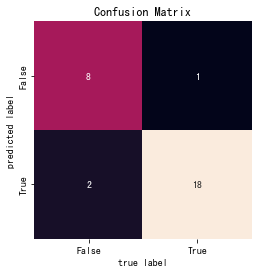

In [364]:
lucem_illud.plotConfusionMatrix(logistic, train_data)

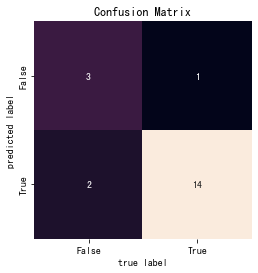

In [362]:
lucem_illud.plotConfusionMatrix(logistic, test_data)

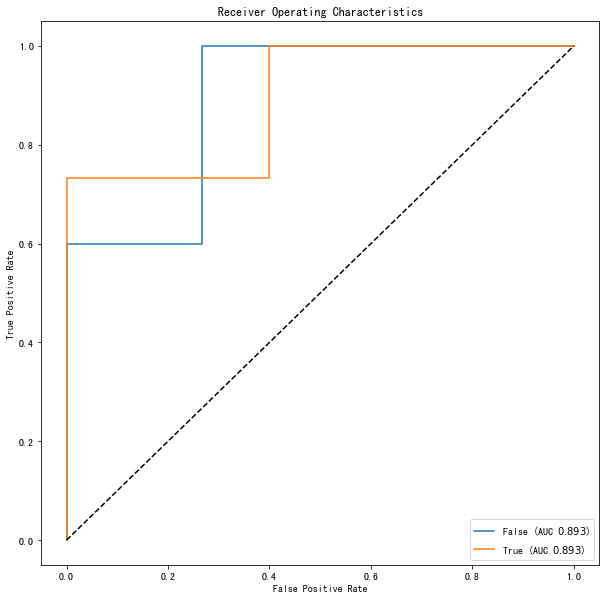

In [365]:
lucem_illud.plotMultiROC(logistic, test_data)

Extrapolation to uncoded data(75)

In [367]:
reviews_all = pd.read_csv('/Users/mao_shiba/Desktop/2021-Content-Analysis/Movie_Comments/moviedata-10m/moviedata-10m/comments.csv')
reviews_all = reviews_all.loc[:, ['COMMENT_TIME','CONTENT', 'MOVIE_ID']]
reviews_all['COMMENT_TIME'] = pd.to_datetime(reviews_all['COMMENT_TIME'])
reviews_all = reviews_all.sort_values(by = 'COMMENT_TIME')
reviews_all = reviews_all.set_index('COMMENT_TIME', drop=True)
reviews_all.head()

,CONTENT,MOVIE_ID
COMMENT_TIME,,
2005-06-12 02:22:07,我爱特拉沃塔的舞。,1291832
2005-06-12 02:22:07,平安夜跟小白看了粤语版，驴子的台词再创造得很可爱。,1291581
2005-06-12 02:22:07,20061118跟小白重看了一遍。,1291582
2005-06-12 02:22:07,http://www.bighead.cn/?p=15,1291856
2005-06-12 02:22:09,重看依然很喜欢很喜欢,1292210


In [368]:
time_slice = reviews_all.groupby(reviews_all.index.year).count()
time_slice = time_slice['CONTENT'].to_list()

In [369]:
def choose_n_from_df(corpus, time_slices, nums=500):
    new_corpus = corpus.iloc[0:nums]
    start = time_slices[0]
    for time_slice in time_slices[1:]:
        new_corpus = pd.concat([new_corpus, corpus.iloc[start:start+nums*200: 200]], axis=0)
        start += time_slice
    return new_corpus

In [370]:
small_reviews = choose_n_from_df(reviews_all, time_slice, nums=5)

In [372]:
small_reviews.reset_index()

,COMMENT_TIME,CONTENT,MOVIE_ID
0,2005-06-12 02:22:07,我爱特拉沃塔的舞。,1291832
1,2005-06-12 02:22:07,平安夜跟小白看了粤语版，驴子的台词再创造得很可爱。,1291581
2,2005-06-12 02:22:07,20061118跟小白重看了一遍。,1291582
3,2005-06-12 02:22:07,http://www.bighead.cn/?p=15,1291856
4,2005-06-12 02:22:09,重看依然很喜欢很喜欢,1292210
...,...,...,...
70,2018-12-31 23:59:36,虽然女主时而龟毛，时而脑残，但还是想说很久没有看到过如此把心提到嗓子眼的恐怖片了,27617348
71,2019-01-01 01:45:32,最后一个镜头没弄明白 不过还可以 没想到2019年第一部电影是这个哈哈哈哈,26857617
72,2019-01-01 06:14:40,结局还是温暖的 这女的还是很淡定的 老公死了都还在探究在线 牛嘛批,25833913
73,2019-01-01 10:59:48,舞美灯光音效都没话讲，请的歌手嘉宾也都很棒，但是几位大咖选的歌我接受不了，尤其林俊杰和蔡依林...,30408074


In [373]:
small_reviews['CONTENT'].replace('[^\u4e00-\u9fa5A-Za-z0-9]+', ' ', regex = True, inplace=True)

In [374]:
small_reviews['simplified'] = small_reviews['CONTENT'].apply(simplify)

In [375]:
small_reviews['cut_words'] = small_reviews['simplified'].apply(cut_words)

In [376]:
empty_lst = []
for index, row in small_reviews.iterrows():
    if row['cut_words'] == []:
        empty_lst.append(index)

small_reviews.drop(empty_lst, axis=0, inplace=True)

In [378]:
small_reviews.reset_index()

,COMMENT_TIME,CONTENT,MOVIE_ID,simplified,cut_words
0,2005-06-12 02:22:07,我爱特拉沃塔的舞,1291832,我爱特拉沃塔的舞,"[我爱特, 拉沃, 塔, 舞]"
1,2005-06-12 02:22:07,平安夜跟小白看了粤语版 驴子的台词再创造得很可爱,1291581,平安夜跟小白看了粤语版 驴子的台词再创造得很可爱,"[平安夜, 小白, 粤语版, 驴子, 台词, 创造, 可爱]"
2,2005-06-12 02:22:07,20061118跟小白重看了一遍,1291582,20061118跟小白重看了一遍,"[20061118, 小白重, 一遍]"
3,2005-06-12 02:22:07,http www bighead cn p 15,1291856,http www bighead cn p 15,"[http, www, bighead, cn, p, 15]"
4,2005-06-12 02:22:09,重看依然很喜欢很喜欢,1292210,重看依然很喜欢很喜欢,"[重看, 依然, 喜欢, 喜欢]"
...,...,...,...,...,...
70,2018-12-31 23:59:36,虽然女主时而龟毛 时而脑残 但还是想说很久没有看到过如此把心提到嗓子眼的恐怖片了,27617348,虽然女主时而龟毛 时而脑残 但还是想说很久没有看到过如此把心提到嗓子眼的恐怖片了,"[女主, 时而, 龟毛, 时而, 脑残, 想, 很久没, 看到, 心, 提到, 嗓子眼, 恐怖片]"
71,2019-01-01 01:45:32,最后一个镜头没弄明白 不过还可以 没想到2019年第一部电影是这个哈哈哈哈,26857617,最后一个镜头没弄明白 不过还可以 没想到2019年第一部电影是这个哈哈哈哈,"[最后, 一个, 镜头, 没弄, 明白, 没想到, 2019, 第一部, 电影, 哈哈哈哈]"
72,2019-01-01 06:14:40,结局还是温暖的 这女的还是很淡定的 老公死了都还在探究在线 牛嘛批,25833913,结局还是温暖的 这女的还是很淡定的 老公死了都还在探究在线 牛嘛批,"[结局, 温暖, 这女, 很淡, 定, 老公, 探究, 在线, 牛嘛批]"
73,2019-01-01 10:59:48,舞美灯光音效都没话讲 请的歌手嘉宾也都很棒 但是几位大咖选的歌我接受不了 尤其林俊杰和蔡依林...,30408074,舞美灯光音效都没话讲 请的歌手嘉宾也都很棒 但是几位大咖选的歌我接受不了 尤其林俊杰和蔡依林...,"[舞美, 灯光, 音效, 没话, 讲, 请, 歌手, 嘉宾, 很棒, 几位, 咖选, 歌, ..."


In [379]:
small_reviews['vect'] = small_reviews['cut_words'].apply(get_avg_vect)

In [408]:
pca = sklearn.decomposition.PCA()
reduced_data = pca.fit_transform(np.stack(small_reviews['vect'], axis=0))
small_reviews['pca'] = [r for r in reduced_data]
small_reviews['pca_reduced_10'] = small_reviews['pca'].apply(lambda x: x[:10])

In [409]:
small_reviews

,CONTENT,MOVIE_ID,simplified,cut_words,vect,pca,pca_reduced_10
COMMENT_TIME,,,,,,,
2005-06-12 02:22:07,我爱特拉沃塔的舞,1291832,我爱特拉沃塔的舞,"[我爱特, 拉沃, 塔, 舞]","[-0.666462168097496, -0.4975779913365841, -0.2...","[-2.7491722641892515, 3.0198532662405424, -2.7...","[-2.7491722641892515, 3.0198532662405424, -2.7..."
2005-06-12 02:22:07,平安夜跟小白看了粤语版 驴子的台词再创造得很可爱,1291581,平安夜跟小白看了粤语版 驴子的台词再创造得很可爱,"[平安夜, 小白, 粤语版, 驴子, 台词, 创造, 可爱]","[-0.12607407569885254, -0.23720006006104605, 0...","[-1.0215403199674542, 1.7606247651926423, -0.5...","[-1.0215403199674542, 1.7606247651926423, -0.5..."
2005-06-12 02:22:07,20061118跟小白重看了一遍,1291582,20061118跟小白重看了一遍,"[20061118, 小白重, 一遍]","[-1.242615779240926, 0.6756441593170166, -0.05...","[-1.1126361863751564, 1.4159136443690328, 0.65...","[-1.1126361863751564, 1.4159136443690328, 0.65..."
2005-06-12 02:22:07,http www bighead cn p 15,1291856,http www bighead cn p 15,"[http, www, bighead, cn, p, 15]","[1.0634741733471553, 0.7151256538927555, -0.47...","[-3.2965124455573434, 2.73404878143249, -0.879...","[-3.2965124455573434, 2.73404878143249, -0.879..."
2005-06-12 02:22:09,重看依然很喜欢很喜欢,1292210,重看依然很喜欢很喜欢,"[重看, 依然, 喜欢, 喜欢]","[-1.1942702382802963, -0.6057174801826477, 0.3...","[1.6408471180093815, 0.046075126836705706, -0....","[1.6408471180093815, 0.046075126836705706, -0...."
...,...,...,...,...,...,...,...
2018-12-31 23:59:36,虽然女主时而龟毛 时而脑残 但还是想说很久没有看到过如此把心提到嗓子眼的恐怖片了,27617348,虽然女主时而龟毛 时而脑残 但还是想说很久没有看到过如此把心提到嗓子眼的恐怖片了,"[女主, 时而, 龟毛, 时而, 脑残, 想, 很久没, 看到, 心, 提到, 嗓子眼, 恐怖片]","[0.1071120190123717, 1.128711103151242, 0.3484...","[-0.8239558300697305, 0.007105874732965899, 1....","[-0.8239558300697305, 0.007105874732965899, 1...."
2019-01-01 01:45:32,最后一个镜头没弄明白 不过还可以 没想到2019年第一部电影是这个哈哈哈哈,26857617,最后一个镜头没弄明白 不过还可以 没想到2019年第一部电影是这个哈哈哈哈,"[最后, 一个, 镜头, 没弄, 明白, 没想到, 2019, 第一部, 电影, 哈哈哈哈]","[-0.6037396803498268, 0.9816641345620155, 0.30...","[-0.02862743380358208, -1.9461419354326495, 1....","[-0.02862743380358208, -1.9461419354326495, 1...."
2019-01-01 06:14:40,结局还是温暖的 这女的还是很淡定的 老公死了都还在探究在线 牛嘛批,25833913,结局还是温暖的 这女的还是很淡定的 老公死了都还在探究在线 牛嘛批,"[结局, 温暖, 这女, 很淡, 定, 老公, 探究, 在线, 牛嘛批]","[0.36860619319809806, -0.38310676709645325, -0...","[-1.0530269919999506, -0.23686384007541486, 0....","[-1.0530269919999506, -0.23686384007541486, 0...."


In [414]:
tag = logistic.predict(np.stack(small_reviews['pca_reduced_10']))

In [415]:
pred_result = pd.DataFrame(small_reviews['CONTENT'])
pred_result['category'] = tag

In [417]:
pred_result[pred_result['category'] == False]

,CONTENT,category
COMMENT_TIME,,
2005-06-12 02:22:09,重看依然很喜欢很喜欢,False
2006-01-08 20:01:47,逗是很逗 笑得我呛了n口水 以后看的时候不能喝水 嘴里不能有东西 太逗了 尤其喜欢那个健美操老师,False
2006-01-17 06:49:50,一个勇敢坚定的女人 真正的妻子 真正的母亲,False
2006-01-22 23:00:22,达明的同名歌提供这部电影最好的注解 有青春的人对待世界好残酷 世界对待青春的人亦都好残酷,False
2007-01-01 00:05:57,当我们相信自己已经对这个世界相当重要的时候 其实这个世界才刚刚开始准备原谅我们的幼稚 锦衣夜...,False
2007-01-13 21:26:49,无趣的片 难看难看难看 女的也不漂亮 男的还凑合,False
2008-01-01 00:21:04,我也很努力地想喜欢上苍井同学呀 但是真的又不行呀 眼缘 跟缘分一样是个莫名其妙喜怒无常的小女人,False
2008-01-05 14:14:05,tough 勇气 pride 荣誉,False
2009-01-01 18:09:47,看的时候还小 但记忆很深 新中国的红日就是这样升起来的 现在看来 张灵甫和朱镕基一样 人才活...,False


From my opinion, the accruracy of classifying False category is better than guess, but the result is not very satisfying. 

# Decision Trees

Decision trees can be used to predict both categorical/class labels (i.e., classification) and continuous labels (i.e., regression).

In [ ]:
blobs_df = lucem_illud.multiBlobs(noise=.2, centers=[(0,0), (0,5), (5,0), (-5,0), (0,-5)])
df_exampleTree_train, df_exampleTree_test = sklearn.model_selection.train_test_split(blobs_df, test_size=.2)
lucem_illud.plotter(df_exampleTree_train)

Now we import our Decision Tree classifier from sklearn.tree (familiar syntax) and fit it using the fit method.

In [ ]:
clf_tree = sklearn.tree.DecisionTreeClassifier(max_depth=4,random_state=0)
clf_tree.fit(np.stack(df_exampleTree_train['vect'], axis =0), df_exampleTree_train['category'])

To see what's going on visually with the classification: 

In [ ]:
lucem_illud.plotregions(clf_tree, df_exampleTree_train)

In [ ]:
lucem_illud.evaluateClassifier(clf_tree, df_exampleTree_test)

Lets look at accuracy:

In [ ]:
sklearn.metrics.accuracy_score(df_exampleTree_test['category'],clf_tree.predict(np.stack(df_exampleTree_test['vect'], axis = 0)))

What happens if we trim the tree?

In [ ]:
depthvec = []
scorevec = []
for i in range(1,20):
    tree2 = sklearn.tree.DecisionTreeClassifier(max_depth=i,random_state=0)
    tree2.fit(np.stack(df_exampleTree_train['vect'], axis =0), df_exampleTree_train['category'])
    score = sklearn.metrics.accuracy_score(df_exampleTree_test['category'], tree2.predict(np.stack(df_exampleTree_test['vect'], axis = 0)))
    depthvec.append(i)
    scorevec.append(score)
plt.scatter(depthvec,scorevec)
plt.show()

We can select different layers of the decision tree or "prune" it. At approximately four layers down in the decision tree, the shape is somewhat odd, suggesting that our model is overfitting beyond those four layers.

Combining multiple overfitting estimators turns out to be a key idea in machine learning. This is called **bagging** and is a type of **ensemble** method. The idea is to make many randomized estimators--each can overfit, as decision trees are wont to do--but then to combine them, ultimately producing a better classification. A **random forest** is produced by bagging decision trees.

In [ ]:
tree = sklearn.tree.DecisionTreeClassifier(max_depth=10) #Create an instance of our decision tree classifier.

bag = sklearn.ensemble.BaggingClassifier(tree, n_estimators=100, max_samples=0.8, random_state=1) #Each tree uses up to 80% of the data

In [ ]:
bag.fit(np.stack(df_exampleTree_train['vect'], axis =0), df_exampleTree_train['category']) #Fit the bagged classifier

In [ ]:
lucem_illud.plotregions(bag, df_exampleTree_test)

In [ ]:
lucem_illud.evaluateClassifier(bag, df_exampleTree_test)

In [ ]:
lucem_illud.plotConfusionMatrix(bag, df_exampleTree_test)

## <font color="red">*Exercise 4*</font>

<font color="red">In the cells immediately following, perform decision tree and random forest classification (binary, multinomial or continuous) using training, testing and extrapolation (uncoded) data from texts and hand-classifications associated with your final project. As with ***Exercise 2***, these could be crowd-sourced codes gathered through Amazon Mechanical Turk last week. Visualize the classification of data points. Calculate relevant metrics (e.g., precision, recall, the F-measure, and AUC). Now build an ensemble classifier by bagging trees into a random forest. Visualize the result. How do these classifiers perform? What does ensemble learning do?

In [418]:
clf_tree = sklearn.tree.DecisionTreeClassifier(max_depth=4,random_state=0)

In [419]:
clf_tree.fit(np.stack(train_data_df['pca_reduced_10'], axis=0), train_data_df['category'])

DecisionTreeClassifier(max_depth=4, random_state=0)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


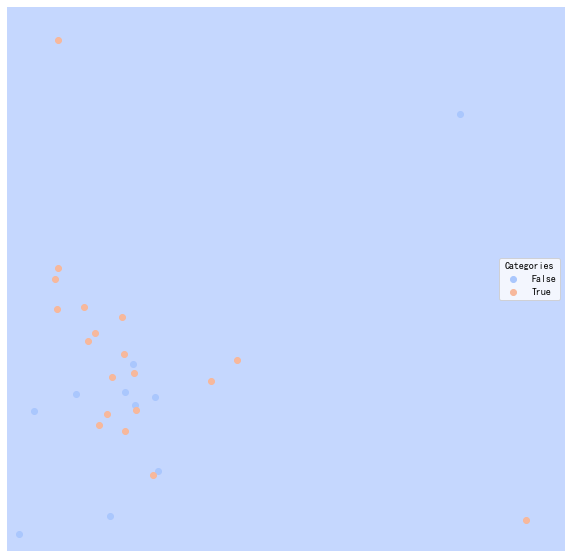

In [421]:
lucem_illud.plotregions(clf_tree, train_data)

Not a good classification. It seems that we need more layers. And we need more samples. 

In [422]:
lucem_illud.evaluateClassifier(clf_tree, test_data)

,Error_Rate,AUC,Precision,Average_Precision,Recall
Category,,,,,
False,0.3,0.533333,0.333333,0.266667,0.200000
True,0.3,0.533333,0.764706,0.762745,0.866667


In [423]:
sklearn.metrics.accuracy_score(test_data['category'],
                               clf_tree.predict(np.stack(test_data['vect'], axis = 0)))

0.7

In [425]:
tree = sklearn.tree.DecisionTreeClassifier(max_depth=10) #Create an instance of our decision tree classifier.

bag = sklearn.ensemble.BaggingClassifier(tree, n_estimators=100, max_samples=0.8, random_state=1) #Each tree uses up to 80% of the data

In [426]:
bag.fit(np.stack(train_data['vect'], axis =0), train_data['category']) #Fit the bagged classifier

BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=10),
                  max_samples=0.8, n_estimators=100, random_state=1)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


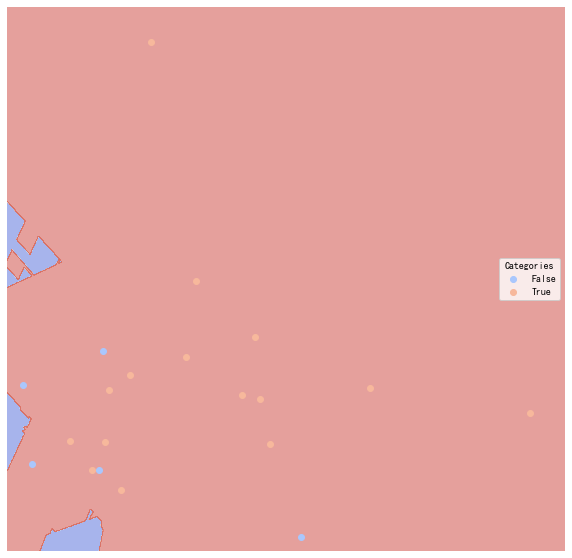

In [427]:
lucem_illud.plotregions(bag, test_data)

In [459]:
measure_df = lucem_illud.evaluateClassifier(bag, test_data)

In [460]:
measure_df['f_measure'] = 2 * measure_df['Precision'] * measure_df['Recall']/(measure_df['Precision'] + measure_df['Recall'])

In [461]:
measure_df

,Error_Rate,AUC,Precision,Average_Precision,Recall,f_measure
Category,,,,,,
False,0.2,0.6,1.000000,0.400000,0.2,0.333333
True,0.2,0.6,0.789474,0.789474,1.0,0.882353


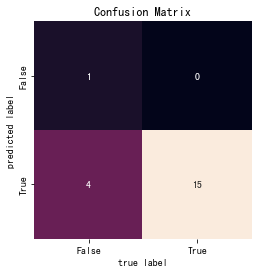

In [429]:
lucem_illud.plotConfusionMatrix(bag, test_data)

Well, it seems that this is an umbalanced test dataset, and the classifier is learning how to cheat. But the ensemble classifier could do sophisticated classification. The problem is that the classifier tends to category False category as True category. 

In [433]:
tag_tree = bag.predict(np.stack(small_reviews['pca_reduced_10']))

In [434]:
pred_result['category_tree'] = tag_tree

In [446]:
pred_result = pred_result.rename(columns = {'CONTENT':'Content', 
                              'category':'category_logistic', 
                              'category_tree':'category_bag_trees'})

pred_result

,Content,category_logistic,category_bag_trees
COMMENT_TIME,,,
2005-06-12 02:22:07,我爱特拉沃塔的舞,True,True
2005-06-12 02:22:07,平安夜跟小白看了粤语版 驴子的台词再创造得很可爱,True,True
2005-06-12 02:22:07,20061118跟小白重看了一遍,True,True
2005-06-12 02:22:07,http www bighead cn p 15,True,True
2005-06-12 02:22:09,重看依然很喜欢很喜欢,False,True
...,...,...,...
2018-12-31 23:59:36,虽然女主时而龟毛 时而脑残 但还是想说很久没有看到过如此把心提到嗓子眼的恐怖片了,True,True
2019-01-01 01:45:32,最后一个镜头没弄明白 不过还可以 没想到2019年第一部电影是这个哈哈哈哈,True,True
2019-01-01 06:14:40,结局还是温暖的 这女的还是很淡定的 老公死了都还在探究在线 牛嘛批,True,True


In [448]:
pred_result[pred_result['category_logistic'] == False].reset_index()

,COMMENT_TIME,Content,category_logistic,category_bag_trees
0,2005-06-12 02:22:09,重看依然很喜欢很喜欢,False,True
1,2006-01-08 20:01:47,逗是很逗 笑得我呛了n口水 以后看的时候不能喝水 嘴里不能有东西 太逗了 尤其喜欢那个健美操老师,False,True
2,2006-01-17 06:49:50,一个勇敢坚定的女人 真正的妻子 真正的母亲,False,False
3,2006-01-22 23:00:22,达明的同名歌提供这部电影最好的注解 有青春的人对待世界好残酷 世界对待青春的人亦都好残酷,False,True
4,2007-01-01 00:05:57,当我们相信自己已经对这个世界相当重要的时候 其实这个世界才刚刚开始准备原谅我们的幼稚 锦衣夜...,False,False
5,2007-01-13 21:26:49,无趣的片 难看难看难看 女的也不漂亮 男的还凑合,False,False
6,2008-01-01 00:21:04,我也很努力地想喜欢上苍井同学呀 但是真的又不行呀 眼缘 跟缘分一样是个莫名其妙喜怒无常的小女人,False,True
7,2008-01-05 14:14:05,tough 勇气 pride 荣誉,False,False
8,2009-01-01 18:09:47,看的时候还小 但记忆很深 新中国的红日就是这样升起来的 现在看来 张灵甫和朱镕基一样 人才活...,False,True
9,2009-01-03 11:18:25,原来女主角那么老,False,False


From my opinion, the performance of random forest is better than logistic regression, at least at classifying false category movie reviews. For example, review 0, 1, 6, 11, and 15 have personal preferences and the random forest correctly classify them into the True category. It shows that the ensemble of tree estimators learned recognizing sentiments of movie reviews. 

# K-Nearest Neighbors

The K-Nearest neighbors classifier takes a simpler premise than those before: Find the closest labeled datapoint in set and "borrow" its label.

Let's use newsgroup data.

In [ ]:
newsgroups = sklearn.datasets.fetch_20newsgroups(data_home = '../data') #Free data to play with: documents from a newsgroup corpus.
newsgroups.target_names #Possible categories, i.e., the newsgroups

target_categories = ['talk.religion.misc', 'soc.religion.christian', 'sci.space', 'comp.graphics'] #Can change these of course

newsgroupsDF = pandas.DataFrame(columns = ['text', 'category', 'source_file'])
for category in target_categories:
    print("Loading data for: {}".format(category))
    ng = sklearn.datasets.fetch_20newsgroups(categories = [category], remove=['headers', 'footers', 'quotes'], data_home = '../data')
    newsgroupsDF = newsgroupsDF.append(pandas.DataFrame({'text' : ng.data, 'category' : [category] * len(ng.data), 'source_file' : ng.filenames}), ignore_index=True)

newsgroupsDF['tokenized_text'] = newsgroupsDF['text'].apply(lambda x: lucem_illud.word_tokenize(x))
newsgroupsDF['normalized_text'] = newsgroupsDF['tokenized_text'].apply(lambda x: lucem_illud.normalizeTokens(x))

In [ ]:
newsgroupsDF[:5]

Make a testing and training set:

In [ ]:
holdBackFraction = .2
train_ng_df, test_ng_df = sklearn.model_selection.train_test_split(newsgroupsDF, test_size=holdBackFraction)

Let's initialize our k-nearest neighbors classifier:

In [ ]:
n_neighbors = 15
weights="uniform"
clf_knearest = sklearn.neighbors.KNeighborsClassifier(n_neighbors, weights=weights)

Let's try to classify using the TF-IDF vectors:

In [ ]:
TFVectorizer_ng = sklearn.feature_extraction.text.TfidfVectorizer(max_df=100, min_df=2, stop_words='english', norm='l2')
TFVects_ng = TFVectorizer_ng.fit_transform(train_ng_df['text'])
train_ng_df['vect'] = [np.array(v).flatten() for v in TFVects_ng.todense()]

In [ ]:
clf_knearest.fit(np.stack(train_ng_df['vect'], axis = 0), train_ng_df['category'])

In [ ]:
lucem_illud.evaluateClassifier(clf_knearest, train_ng_df)

And lets look at the testing data

In [ ]:
#Create vectors
TFVects_test = TFVectorizer_ng.transform(test_ng_df['text'])
test_ng_df['vect'] = [np.array(v).flatten() for v in TFVects_test.todense()]

#Add to df
test_ng_df['nb_predict'] = clf_knearest.predict(np.stack(test_ng_df['vect'], axis=0))

#Test
print("Testing score:")
print(clf_knearest.score(np.stack(test_ng_df['vect'], axis=0), test_ng_df['category']))

Let's produce another confusion matrix:

In [ ]:
lucem_illud.plotConfusionMatrix(clf_knearest, test_ng_df)

You can produce the PCA space visual if you want, altough it can take a very long time, so we'll leave it optionally commented out:

In [ ]:
#lucem_illud.plotregions(clf_knearest, test_ng_df)

## <font color="red">*Exercise 5*</font>

<font color="red">In the cells immediately following, perform and visualize k-nearest neighbor classification using training, testing and extrapolation (uncoded) data from texts and hand-classifications associated with your final project. Visualize the classification of data points and calculate relevant metrics (e.g., precision, recall, the F-measure, and AUC). Articulate how the *k*-nearest neighbor approach relates to *k*-means clustering explored in ***week 3***?

In [450]:
n_neighbors = 15
weights="uniform"
clf_knearest = sklearn.neighbors.KNeighborsClassifier(n_neighbors, weights=weights)

In [451]:
clf_knearest.fit(np.stack(train_data['vect'], axis = 0), train_data['category'])

KNeighborsClassifier(n_neighbors=15)

In [453]:
measure_df = lucem_illud.evaluateClassifier(clf_knearest, test_data)

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [454]:
measure_df['f_measure'] = 2 * measure_df['Precision'] * measure_df['Recall']/(measure_df['Precision'] + measure_df['Recall'])

In [455]:
measure_df

,Error_Rate,AUC,Precision,Average_Precision,Recall,f_measure
Category,,,,,,
False,0.25,0.5,0.00,0.25,0.0,NaN
True,0.25,0.5,0.75,0.75,1.0,0.857143


In [456]:
print(clf_knearest.score(np.stack(test_data['vect'], axis=0), test_data['category']))

0.75


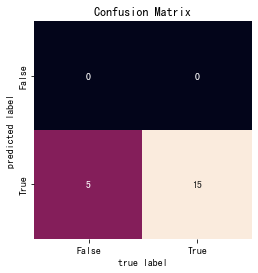

In [458]:
lucem_illud.plotConfusionMatrix(clf_knearest, test_data)

It is worse than random forest. Since the test dataset is unbalanced, KNN learned how to cheat: The recall of false category is 0!. It simply predicts all reviews as True category. 

In [462]:
tag_KNN = clf_knearest.predict(np.stack(small_reviews['pca_reduced_10']))

In [463]:
pred_result['category_KNN'] = tag_KNN

In [464]:
pred_result

,Content,category_logistic,category_bag_trees,category_KNN
COMMENT_TIME,,,,
2005-06-12 02:22:07,我爱特拉沃塔的舞,True,True,True
2005-06-12 02:22:07,平安夜跟小白看了粤语版 驴子的台词再创造得很可爱,True,True,True
2005-06-12 02:22:07,20061118跟小白重看了一遍,True,True,True
2005-06-12 02:22:07,http www bighead cn p 15,True,True,True
2005-06-12 02:22:09,重看依然很喜欢很喜欢,False,True,True
...,...,...,...,...
2018-12-31 23:59:36,虽然女主时而龟毛 时而脑残 但还是想说很久没有看到过如此把心提到嗓子眼的恐怖片了,True,True,True
2019-01-01 01:45:32,最后一个镜头没弄明白 不过还可以 没想到2019年第一部电影是这个哈哈哈哈,True,True,True
2019-01-01 06:14:40,结局还是温暖的 这女的还是很淡定的 老公死了都还在探究在线 牛嘛批,True,True,True


In [465]:
pred_result[pred_result['category_logistic'] == False]

,Content,category_logistic,category_bag_trees,category_KNN
COMMENT_TIME,,,,
2005-06-12 02:22:09,重看依然很喜欢很喜欢,False,True,True
2006-01-08 20:01:47,逗是很逗 笑得我呛了n口水 以后看的时候不能喝水 嘴里不能有东西 太逗了 尤其喜欢那个健美操老师,False,True,True
2006-01-17 06:49:50,一个勇敢坚定的女人 真正的妻子 真正的母亲,False,False,True
2006-01-22 23:00:22,达明的同名歌提供这部电影最好的注解 有青春的人对待世界好残酷 世界对待青春的人亦都好残酷,False,True,True
2007-01-01 00:05:57,当我们相信自己已经对这个世界相当重要的时候 其实这个世界才刚刚开始准备原谅我们的幼稚 锦衣夜...,False,False,True
2007-01-13 21:26:49,无趣的片 难看难看难看 女的也不漂亮 男的还凑合,False,False,True
2008-01-01 00:21:04,我也很努力地想喜欢上苍井同学呀 但是真的又不行呀 眼缘 跟缘分一样是个莫名其妙喜怒无常的小女人,False,True,True
2008-01-05 14:14:05,tough 勇气 pride 荣誉,False,False,True
2009-01-01 18:09:47,看的时候还小 但记忆很深 新中国的红日就是这样升起来的 现在看来 张灵甫和朱镕基一样 人才活...,False,True,True


As we mentioned above, this case, KNN learned how to cheat. It simply predicts all reviews as true category. 

KNN has similar ideas to k-means clustering. KNN borrows nearest K neighbors' features to label the current selected point, while k-means calculates whether a specific point is close enough to a selected centriod. Both methods emphasize that distance matters. 

# SVMs

Now we will examine Support Vector Machines, an approach that creates the partition that preserves the "maximum margin" between classes.

We will use a few sub forums from reddit--which tend to share text rather than memes--namely `talesfromtechsupport`, `badroommates`, `weeabootales` and `relationships`. The top 100 text posts from each have been saved to `data/reddit.csv`.

In [ ]:
redditDf = pandas.read_csv('../data/reddit.csv', index_col = 0)

#Drop a couple missing values

redditDf = redditDf.dropna()

#Set category

redditDf['category'] = redditDf['subreddit']

#tokenize and normalize
redditDf['tokenized_text'] = redditDf['text'].apply(lambda x: lucem_illud.word_tokenize(x))
redditDf['normalized_text'] = redditDf['tokenized_text'].apply(lambda x: lucem_illud.normalizeTokens(x))

We will tf.idf the data to make our vectors:

In [ ]:
redditTFVectorizer = sklearn.feature_extraction.text.TfidfVectorizer(max_df=0.5, min_df=3, stop_words='english', norm='l2')
redditTFVects = redditTFVectorizer.fit_transform([' '.join(l) for l in redditDf['normalized_text']])
redditDf['vect'] = [np.array(v).flatten() for v in redditTFVects.todense()]

Initilize the model and make a train test split:

In [ ]:
holdBackFraction = .2
train_redditDf, test_redditDf = sklearn.model_selection.train_test_split(redditDf, test_size=holdBackFraction)

In [ ]:
clf_svm = sklearn.svm.SVC(kernel='linear', probability = False)
#probability = True is slower but  lets you call predict_proba()
clf_svm.fit(np.stack(train_redditDf['vect'], axis=0), train_redditDf['category'])

...and consider the results:

In [ ]:
lucem_illud.evaluateClassifier(clf_svm, test_redditDf)

In [ ]:
lucem_illud.plotConfusionMatrix(clf_svm, test_redditDf)

In [ ]:
lucem_illud.plotregions(clf_svm, test_redditDf)

# Neural Nets

We include an example of a simple neural network, the Multi-layer Perceptron (MLP) that learns a function $f(\cdot): R^m \rightarrow R^o$ by training on a dataset, where $m$ is the number of dimensions for input and $o$ is the number of dimensions for output. Given a set of features $X = {x_1, x_2, ..., x_m}$ and a target $y$, it can learn a non-linear function approximator for either classification or regression. It is different from logistic regression, in that between the input and the output layer, there can be one or more non-linear layers, called hidden layers. The following figure shows a one hidden layer MLP with scalar output. ![title](../data/multilayerperceptron_network.png) The leftmost layer, known as the input layer, consists of a set of "neurons" $\{x_i | x_1, x_2, ..., x_m\}$ representing the input features (e.g., weighted words). Each neuron in the hidden layer transforms the values from the previous layer with a weighted linear summation $w_1x_1 + w_2x_2 + ... + w_mx_m$, followed by a non-linear activation function $g(\cdot):R \rightarrow R$ - like the logistic or hyperbolic tan function. The output layer receives the values from the last hidden layer and transforms them into output values.

In [ ]:
clf_nn = sklearn.neural_network.MLPClassifier()
clf_nn.fit(np.stack(train_redditDf['vect'], axis=0), train_redditDf['category'])

In [ ]:
lucem_illud.evaluateClassifier(clf_nn, test_redditDf)

In [ ]:
lucem_illud.plotConfusionMatrix(clf_nn, test_redditDf)

In [ ]:
lucem_illud.plotregions(clf_nn, test_redditDf)

It performs very well.

## <font color="red">*Exercise 6*</font>

<font color="red">In the cells immediately following, perform a neural network classification and calculate relevant metrics (e.g., precision, recall, the F-measure, and AUC). How does this classify relevant to *k*-nearest neighbor, logistic and decision-tree approaches?

In [466]:
clf_nn = sklearn.neural_network.MLPClassifier()
clf_nn.fit(np.stack(train_data['vect'], axis=0), train_data['category'])

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


MLPClassifier()

In [467]:
measure_df = lucem_illud.evaluateClassifier(clf_nn, test_data)

In [468]:
measure_df['f_measure'] = 2 * measure_df['Precision'] * measure_df['Recall']/(measure_df['Precision'] + measure_df['Recall'])

In [469]:
measure_df

,Error_Rate,AUC,Precision,Average_Precision,Recall,f_measure
Category,,,,,,
False,0.15,0.7,1.000000,0.550000,0.4,0.571429
True,0.15,0.7,0.833333,0.833333,1.0,0.909091


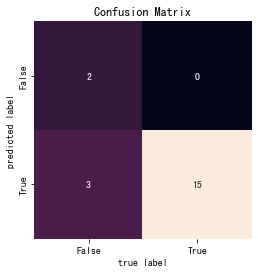

In [470]:
lucem_illud.plotConfusionMatrix(clf_nn, test_data)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


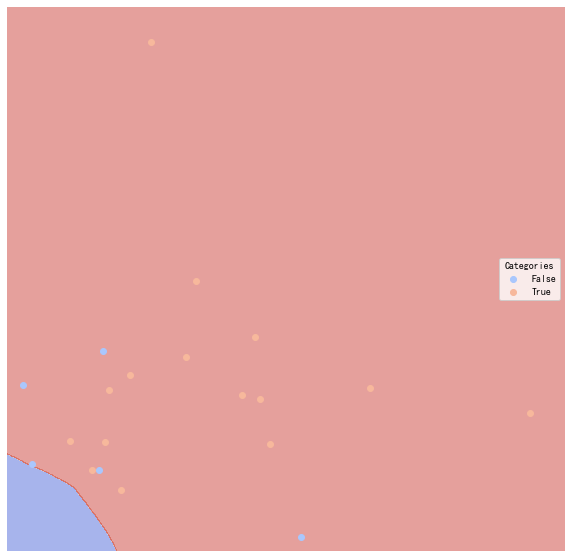

In [471]:
lucem_illud.plotregions(clf_nn, test_data)

In [472]:
tag_MLP = clf_nn.predict(np.stack(small_reviews['pca_reduced_10']))

In [473]:
pred_result['category_MLP'] = tag_MLP

In [476]:
pred_result.head()

,Content,category_logistic,category_bag_trees,category_KNN,category_MLP
COMMENT_TIME,,,,,
2005-06-12 02:22:07,我爱特拉沃塔的舞,True,True,True,True
2005-06-12 02:22:07,平安夜跟小白看了粤语版 驴子的台词再创造得很可爱,True,True,True,True
2005-06-12 02:22:07,20061118跟小白重看了一遍,True,True,True,True
2005-06-12 02:22:07,http www bighead cn p 15,True,True,True,True
2005-06-12 02:22:09,重看依然很喜欢很喜欢,False,True,True,False


In [478]:
pred_result[pred_result['category_logistic'] == False]

,Content,category_logistic,category_bag_trees,category_KNN,category_MLP
COMMENT_TIME,,,,,
2005-06-12 02:22:09,重看依然很喜欢很喜欢,False,True,True,False
2006-01-08 20:01:47,逗是很逗 笑得我呛了n口水 以后看的时候不能喝水 嘴里不能有东西 太逗了 尤其喜欢那个健美操老师,False,True,True,False
2006-01-17 06:49:50,一个勇敢坚定的女人 真正的妻子 真正的母亲,False,False,True,False
2006-01-22 23:00:22,达明的同名歌提供这部电影最好的注解 有青春的人对待世界好残酷 世界对待青春的人亦都好残酷,False,True,True,False
2007-01-01 00:05:57,当我们相信自己已经对这个世界相当重要的时候 其实这个世界才刚刚开始准备原谅我们的幼稚 锦衣夜...,False,False,True,False
2007-01-13 21:26:49,无趣的片 难看难看难看 女的也不漂亮 男的还凑合,False,False,True,False
2008-01-01 00:21:04,我也很努力地想喜欢上苍井同学呀 但是真的又不行呀 眼缘 跟缘分一样是个莫名其妙喜怒无常的小女人,False,True,True,False
2008-01-05 14:14:05,tough 勇气 pride 荣誉,False,False,True,False
2009-01-01 18:09:47,看的时候还小 但记忆很深 新中国的红日就是这样升起来的 现在看来 张灵甫和朱镕基一样 人才活...,False,True,True,False


The result of MLPClassifer is not satisfying compared to other methods(It is even worse than logistic regression). I think this complex method requires more labelled data for training.While logistic regression is simple, so it can work well with small size of training dataset. KNN is sensitive to ratio of True/False instances, so it can 'cleverly' learn how to cheat. With a small size of training dataset, MLP is more stupid. In exercise2, we can find that random forest and MLP have similar performance when dealing with datasets with complext distrbution patterns. However, I think MLP is more reliable to a large training dataset to tune the weights in the hidden layers.

## Classification with BERT Pipelines
Now, instead of classifying based on "old" NLP methods, we will now use the popular Transformers package default 'pipelines'. This package has methods for a wide range of common NLP tasks using contextual word embeddings. Note that for this homework, we are not building new contextual models ourselves, merely using existing models in Transformers. We will spend Weeks 7 and 8 learning more about Transformers, so do not worry about fully understanding them this week.

[Transformers Documentation](https://huggingface.co/transformers/)

[Transformers GitHub](https://github.com/huggingface/transformers)

The following sections of code are taken from the [Summary of Tasks](https://huggingface.co/transformers/task_summary.html) page in the Transformers documentation.

### Sequence Classification (e.g., sentiment)
Sequence classification is the task of classifying sequences according to a given number of classes. An example of
sequence classification is the GLUE dataset. If you would like to fine-tune a
model on a GLUE sequence classification task, you may leverage the [run_glue.py](https://github.com/huggingface/transformers/tree/master/examples/text-classification/run_glue.py) and
[run_pl_glue.py](https://github.com/huggingface/transformers/tree/master/examples/text-classification/run_pl_glue.py) or
[run_tf_glue.py](https://github.com/huggingface/transformers/tree/master/examples/text-classification/run_tf_glue.py) scripts.

Here is an example of using pipelines to do sentiment analysis: identifying if a sentence is positive or negative. It
leverages a fine-tuned model on sst2, which is a GLUE task.

This returns a label ("POSITIVE" or "NEGATIVE") alongside a score, as follows:

In [ ]:
from transformers import pipeline
nlp = pipeline("sentiment-analysis")
result = nlp("I hate you")[0]
print(f"label: {result['label']}, with score: {round(result['score'], 4)}")
result = nlp("I love you")[0]
print(f"label: {result['label']}, with score: {round(result['score'], 4)}")

Here is an example of doing a sequence classification using a model to determine if two sequences are paraphrases of
each other. The process is the following:

1. Instantiate a tokenizer and a model from the checkpoint name. The model is identified as a BERT model and loads it
   with the weights stored in the checkpoint.
2. Build a sequence from the two sentences, with the correct model-specific separators token type ids and attention
   masks (`PreTrainedTokenizer.encode` and `PreTrainedTokenizer.__call__` take
   care of this).
3. Pass this sequence through the model so that it is classified in one of the two available classes: 0 (not a
   paraphrase) and 1 (is a paraphrase).
4. Compute the softmax of the result to get probabilities over the classes.
5. Print the results.

In [ ]:
from transformers import AutoTokenizer, AutoModelForSequenceClassification
import torch
tokenizer = AutoTokenizer.from_pretrained("bert-base-cased-finetuned-mrpc")
model = AutoModelForSequenceClassification.from_pretrained("bert-base-cased-finetuned-mrpc")
classes = ["not paraphrase", "is paraphrase"]
sequence_0 = "The company HuggingFace is based in New York City"
sequence_1 = "Apples are especially bad for your health"
sequence_2 = "HuggingFace's headquarters are situated in Manhattan"
paraphrase = tokenizer(sequence_0, sequence_2, return_tensors="pt")
not_paraphrase = tokenizer(sequence_0, sequence_1, return_tensors="pt")
paraphrase_classification_logits = model(**paraphrase).logits
not_paraphrase_classification_logits = model(**not_paraphrase).logits
paraphrase_results = torch.softmax(paraphrase_classification_logits, dim=1).tolist()[0]
not_paraphrase_results = torch.softmax(not_paraphrase_classification_logits, dim=1).tolist()[0]
# Should be paraphrase
for i in range(len(classes)):
    print(f"{classes[i]}: {int(round(paraphrase_results[i] * 100))}%")
# Should not be paraphrase
for i in range(len(classes)):
    print(f"{classes[i]}: {int(round(not_paraphrase_results[i] * 100))}%")

### Extractive Question Answering

Extractive Question Answering is the task of extracting an answer from a text given a question. An example of a
question answering dataset is the SQuAD dataset, which is entirely based on that task. If you would like to fine-tune a
model on a SQuAD task, you may leverage the [run_squad.py](https://github.com/huggingface/transformers/tree/master/examples/question-answering/run_squad.py) and
[run_tf_squad.py](https://github.com/huggingface/transformers/tree/master/examples/question-answering/run_tf_squad.py) scripts.


Here is an example of using pipelines to do question answering: extracting an answer from a text given a question. It
leverages a fine-tuned model on SQuAD.

In [ ]:
from transformers import pipeline
nlp = pipeline("question-answering")
context = r"""
Extractive Question Answering is the task of extracting an answer from a text given a question. An example of a
question answering dataset is the SQuAD dataset, which is entirely based on that task. If you would like to fine-tune
a model on a SQuAD task, you may leverage the examples/question-answering/run_squad.py script.
"""

This returns an answer extracted from the text, a confidence score, alongside "start" and "end" values, which are the
positions of the extracted answer in the text.

In [ ]:
result = nlp(question="What is extractive question answering?", context=context)
print(f"Answer: '{result['answer']}', score: {round(result['score'], 4)}, start: {result['start']}, end: {result['end']}")
result = nlp(question="What is a good example of a question answering dataset?", context=context)
print(f"Answer: '{result['answer']}', score: {round(result['score'], 4)}, start: {result['start']}, end: {result['end']}")

Here is an example of question answering using a model and a tokenizer. The process is the following:

1. Instantiate a tokenizer and a model from the checkpoint name. The model is identified as a BERT model and loads it
   with the weights stored in the checkpoint.
2. Define a text and a few questions.
3. Iterate over the questions and build a sequence from the text and the current question, with the correct
   model-specific separators token type ids and attention masks.
4. Pass this sequence through the model. This outputs a range of scores across the entire sequence of tokens (question and
   text), for both the start and end positions.
5. Compute the softmax of the result to get probabilities over the tokens.
6. Fetch the tokens from the identified start and stop values, convert those tokens to a string.
7. Print the results.

In [ ]:
from transformers import AutoTokenizer, AutoModelForQuestionAnswering
import torch
tokenizer = AutoTokenizer.from_pretrained("bert-large-uncased-whole-word-masking-finetuned-squad")
model = AutoModelForQuestionAnswering.from_pretrained("bert-large-uncased-whole-word-masking-finetuned-squad")
text = r"""
🤗 Transformers (formerly known as pytorch-transformers and pytorch-pretrained-bert) provides general-purpose
architectures (BERT, GPT-2, RoBERTa, XLM, DistilBert, XLNet…) for Natural Language Understanding (NLU) and Natural
Language Generation (NLG) with over 32+ pretrained models in 100+ languages and deep interoperability between
TensorFlow 2.0 and PyTorch.
"""
questions = [
    "How many pretrained models are available in 🤗 Transformers?",
    "What does 🤗 Transformers provide?",
    "🤗 Transformers provides interoperability between which frameworks?",
]
for question in questions:
    inputs = tokenizer(question, text, add_special_tokens=True, return_tensors="pt")
    input_ids = inputs["input_ids"].tolist()[0]

    text_tokens = tokenizer.convert_ids_to_tokens(input_ids)
    outputs = model(**inputs)
    answer_start_scores = outputs.start_logits
    answer_end_scores = outputs.end_logits

    answer_start = torch.argmax(
        answer_start_scores
    )  # Get the most likely beginning of answer with the argmax of the score
    answer_end = torch.argmax(answer_end_scores) + 1  # Get the most likely end of answer with the argmax of the score

    answer = tokenizer.convert_tokens_to_string(tokenizer.convert_ids_to_tokens(input_ids[answer_start:answer_end]))

    print(f"Question: {question}")
    print(f"Answer: {answer}")

## <font color="red">*Exercise 7*</font>

<font color="red">In the cells immediately following, use the pipeline functions or the word or sentence vector functions (e.g., similarity) to explore the social game underlying the production and meaning of texts associated with your final project. How does BERT help you gain insight regarding your research question that is similar and different from prior methods?